In [3]:
import mne
import mne.io

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os, sys
import natsort

%matplotlib inline

In [5]:
def load_data(data_path, timestamp, channel_ids, channel_names):
    data_file_prefix = data_path + "/" + timestamp
    
    raw_time_series = mne.io.read_raw_brainvision(
        vhdr_fname="%s_brainvision.vhdr" % data_file_prefix, montage=None
    )
    
    recorded_data = raw_time_series.get_data()[channel_ids]
    
    recorded_data_info = mne.create_info(
        ch_names=channel_names,
        sfreq=raw_time_series.info['sfreq'], ch_types='eeg'
    )
    recorded_data_time_series = mne.io.RawArray(recorded_data, recorded_data_info)
        
    recorded_data_time_series.load_data()
    recorded_data_time_series.filter(l_freq=0.5, h_freq=1000)
    
    events_data = pd.read_csv(
        "%s_events.csv" % data_file_prefix, header=0
    )
    
    return recorded_data_time_series, events_data

In [6]:
def common_average(raw_time_series):
    raw_data = raw_time_series.get_data()

    common_avg = np.mean(raw_data, axis=0)
    raw_data_common_avg = raw_data - common_avg

    return mne.io.RawArray(raw_data_common_avg, raw_time_series.info)

In [7]:
def epoch_stimulation_site(stimulation_site_row, time_series_raw, offset):

    time_series_data = time_series_raw.get_data().T
    artifact_window_length = int(np.round(time_series_raw.info['sfreq'] / 50))
    
    events_range = np.arange(
        stimulation_site_row[1]['time_begin'],
        stimulation_site_row[1]['time_end'],
        stimulation_site_row[1]['time_interval']
    )

#     time_series_raw.notch_filter(freqs=(50, 100), notch_widths=9)
#     time_series_raw.filter(l_freq=0.5, h_freq=30)
            
    events = np.empty((0, 3), dtype=int)

    t_event_1_beg = stimulation_site_row[1]['time_begin'] + stimulation_site_row[1]['time_interval']
    t_event_1_end = stimulation_site_row[1]['time_end'] - stimulation_site_row[1]['time_interval']
    t_interval = stimulation_site_row[1]['time_interval']

    for t_start in np.arange(t_event_1_beg, t_event_1_end, t_interval):
        events = np.vstack([
            events, 
            np.array([time_series_raw.time_as_index(t_start), 0, 1], dtype=int)
        ])
                        
    event_id = dict(stimulation=1)

    t_min = 0
    t_max = t_interval

    return mne.Epochs(time_series_raw, events, event_id, t_min, t_max) #, baseline=(events_data.loc[stim_id]['time_interval'] - 0.005, events_data.loc[stim_id]['time_interval']))

In [8]:
def plot_local_extrema(data, plot_ylim, offset, p1_lower_bound = 30, p1_upper_bound = 400):
    
    n1 = 0
    n2 = 0
    p1 = 0
    
    arg_min = np.argmin(data[p1_lower_bound : p1_upper_bound])

    if arg_min > 0 and arg_min < p1_upper_bound - 1:
        
        p1 = p1_lower_bound + arg_min
        plt.plot([p1, p1], plot_ylim, 'k:')
        
        lhs_arg_max = np.argmax(data[0 : p1])
        
        if lhs_arg_max > offset and lhs_arg_max < p1 - 1:
            
            n1 = lhs_arg_max
            plt.plot([n1, n1], plot_ylim, 'k:')
            
        rhs_arg_max = np.argmax(data[p1 : ])
        
        if rhs_arg_max > p1:
            
            n2 = p1 + rhs_arg_max
            plt.plot([n2, n2], plot_ylim, 'k:')
            
    return n1, p1, n2
        

In [9]:
def plot_averages(stimulation_site_data, epochs, subplot_rows, subplot_cols, subplot_ids, offset, data_path, prefix):

#     filter_name = "notch45-55_95-105Hz"
#     filter_name = "no-notch"
    filter_name = "band30Hz"
    
    plt.figure(figsize=(2.5 * subplot_cols, 2 * subplot_rows))

    epochs.load_data()
    epoch_data = epochs.get_data()

    avg_data = np.mean(epoch_data, axis=0)
#     avg_data = np.median(epoch_data, axis=0)
    
    plot_xlim = [
        offset, 
        np.minimum(500, avg_data.shape[1])
    ]    
#     plot_ylim = [
#         np.maximum(np.min(avg_data), -0.0015), 
#         np.minimum(np.max(avg_data),  0.0015)
#     ]
    plot_ylim = [
        -0.0008, 0.0003
#         -0.001, 0.0003
    ]
    
    spreadsheets_path = "%s/spreadsheets" % data_path
    if not os.path.isdir(spreadsheets_path):
        os.mkdir(spreadsheets_path)
    
    f_out = open(
        "%s/stim_without_artifact_%s_%sHz_%s_%s.csv" % (
            spreadsheets_path, 
            stimulation_site_data.iloc[0]['stimulation_site'],
            stimulation_site_data.iloc[0]['frequency'],
            prefix, 
            filter_name
        ), 'w'
    )
    
    for avg_channel_name in natsort.natsorted(epochs.ch_names):
        i = epochs.ch_names.index(avg_channel_name)

        plt.subplot(subplot_rows, subplot_cols, subplot_ids[i])
        
        for j in range(epoch_data.shape[0]):
            plt.plot(np.arange(plot_xlim[0], plot_xlim[1]), epoch_data[j, i, plot_xlim[0] : plot_xlim[1]], color=(0.75, 0.75, 0.75))
            
        data = avg_data[i]

        n1, p1, n2 = plot_local_extrema(data, plot_ylim, offset)
#         n1 = 0
#         p1 = 0
#         n2 = 0
        
        nearest_electrodes = stimulation_site_data.iloc[0]['nearest_electrodes'].replace(' ', '').split(',')
        if avg_channel_name in nearest_electrodes:
            plt.plot(np.arange(plot_xlim[0], plot_xlim[1]), data[plot_xlim[0] : plot_xlim[1]], color='red', linewidth=2)    
        else:
            plt.plot(np.arange(plot_xlim[0], plot_xlim[1]), data[plot_xlim[0] : plot_xlim[1]], color='blue', linewidth=2)    

        if subplot_ids[i] + subplot_cols in subplot_ids:
            plt.xticks([])
        else:
            plt.xticks(
                np.arange(0, data.shape[0], 0.1 * epochs.info['sfreq']),
                np.arange(0, data.shape[0] / (0.001 * epochs.info['sfreq']), 100, dtype=int)
            )

        if subplot_ids[i] - 1 in subplot_ids:
            plt.yticks([])
        else:
            plt.yticks([-0.0005, 0])
            
        plt.xlim(plot_xlim)
        plt.ylim(plot_ylim)
        
        plt.title("%s | %d, %d, %d" % (
            avg_channel_name, 
            np.round(n1 / (0.001 * epochs.info['sfreq'])), 
            np.round(p1 / (0.001 * epochs.info['sfreq'])), 
            np.round(n2 / (0.001 * epochs.info['sfreq']))
        ))

        f_out.write("%s, %d, %d, %d, %f, %f, %f\n" % (
            avg_channel_name, 
            np.round(n1 / (0.001 * epochs.info['sfreq'])), 
            np.round(p1 / (0.001 * epochs.info['sfreq'])), 
            np.round(n2 / (0.001 * epochs.info['sfreq'])),
            data[n1], data[p1], data[n2]
        ))

    f_out.close()
    
    images_path = "%s/images" % data_path
    if not os.path.isdir(images_path):
        os.mkdir(images_path)
        
    plt.savefig(
        "%s/stim_without_artifact_%s_%sHz_%s_%s_average.png" % (
            images_path, 
            stimulation_site_data.iloc[0]['stimulation_site'],
            stimulation_site_data.iloc[0]['frequency'],
            prefix, filter_name
        )
    )
    

In [15]:
def plot_epochs(epochs, offset):
    epochs.load_data()
    epoch_data = epochs.get_data()
    
    for i in range(epochs.info['nchan']):
        plt.figure(figsize=(20,5))
        for j in range(epoch_data.shape[0]):
            plt.plot(epoch_data[j, i], color=(0.75, 0.75, 0.75))
            plt.plot(epoch_data[j, i, :offset], color=(1.00, 0.00, 0.00))
  
        plt.ylim([-0.10, 0.10])
    
    sys.exit(1)
    

In [71]:
def stimulation_artifact_amplitudes(epochs, offset):
    epochs.load_data()
    epoch_data = epochs.get_data()
    
    ref_min_value = np.infty
    ref_max_value = -np.infty
    
    j = 0 # we consider the first epoch of each channel
    for i in range(epochs.info['nchan']):
        
        local_min_value = np.min(epoch_data[j, i, :offset])
        local_max_value = np.max(epoch_data[j, i, :offset])
        
        if local_min_value < ref_min_value or local_max_value > ref_max_value:
            ref_min_value = local_min_value
            ref_min_key = np.argmin(epoch_data[j, i, :offset])
            ref_max_value = local_max_value
            ref_max_key = np.argmax(epoch_data[j, i, :offset])

    lhs_key = np.minimum(ref_min_key, ref_max_key)
    rhs_key = np.maximum(ref_min_key, ref_max_key)
        
    margin = 1
    for i in range(epochs.info['nchan']):
        lhs_min = np.min(epoch_data[j, i, lhs_key - margin : lhs_key + margin + 1])
        lhs_max = np.max(epoch_data[j, i, lhs_key - margin : lhs_key + margin + 1])
        rhs_min = np.min(epoch_data[j, i, rhs_key - margin : rhs_key + margin + 1])
        rhs_max = np.max(epoch_data[j, i, rhs_key - margin : rhs_key + margin + 1])
        
        if lhs_min < np.minimum(epoch_data[j, i, lhs_key - margin], epoch_data[j, i, lhs_key + margin]):
            lhs_sign = -1
        else:
            lhs_sign = +1
            
        if rhs_min < np.minimum(epoch_data[j, i, rhs_key - margin], epoch_data[j, i, rhs_key + margin]):
            rhs_sign = -1
        else:
            rhs_sign = +1
            
        if lhs_sign < rhs_sign:
            orientation = "first down"
        elif lhs_sign > rhs_sign:
            orientation = "first up"
        else:
            orientation = "unknown"
            
        plt.figure()
        plt.plot(epoch_data[j, i, :offset + 100])

        plt.plot(np.arange(lhs_key - margin, lhs_key + margin + 1), epoch_data[j, i, lhs_key - margin : lhs_key + margin + 1])
        plt.plot(np.arange(rhs_key - margin, rhs_key + margin + 1), epoch_data[j, i, rhs_key - margin : rhs_key + margin + 1])
        plt.title(orientation)

        plt.ylim([-0.1, 0.1])
        print("%s: %s" % (epochs.info['ch_names'][i], orientation))
    
   

In [72]:
def run(data_path, timestamp, electrode_ids, electrode_names, subplot_rows, subplot_cols, subplot_ids, offset):

    raw_time_series, events_data = load_data(
        data_path, timestamp, electrode_ids, electrode_names
    )

#     common_avg_time_series = common_average(raw_time_series)
    
    for stimulation_site_data in events_data.iterrows():

        print(stimulation_site_data[1]['stimulation_site'])
        epochs_raw = epoch_stimulation_site(stimulation_site_data, raw_time_series, offset)
        stimulation_artifact_amplitudes(epochs_raw, offset)
#         plot_epochs(epochs_raw, offset)
        
#         plot_averages(
#             stimulation_site_data, epochs_raw, 
#             subplot_rows, subplot_cols, subplot_ids, offset,
#             data_path, 'raw'
#         )
        
#         epochs_common_avg = epoch_stimulation_site(stimulation_site_data, common_avg_time_series, offset)
#         plot_averages(
#             stimulation_site_data, epochs_common_avg, 
#             subplot_rows, subplot_cols, subplot_ids, offset,
#             data_path, 'common_avg'
#         )



# Patient #1

Extracting parameters from /home/pfilipia/inria/chu_nice_inria/patients_ecog/patient01/20180507_1240_brainvision.vhdr...
Setting channel info structure...
Currently, 8 trigger(s) will be dropped, such as [parietal location (D), asked Fabien to alternate the probe positions, random location in parietal, S0 stim 5Hz 3.5 mA 1ms, S0 polatrity 2, ...]. Consider using ``event_id`` to parse triggers that do not follow the 'S###' pattern.


<ipython-input-4-1746d64c0cfa>:5: RuntimeWarning: Currently, 8 trigger(s) will be dropped, such as [parietal location (D), asked Fabien to alternate the probe positions, random location in parietal, S0 stim 5Hz 3.5 mA 1ms, S0 polatrity 2, ...]. Consider using ``event_id`` to parse triggers that do not follow the 'S###' pattern.
  vhdr_fname="%s_brainvision.vhdr" % data_file_prefix, montage=None


Creating RawArray with float64 data, n_channels=14, n_times=1866153
    Range : 0 ... 1866152 =      0.000 ...   911.207 secs
Ready.
Setting up band-pass filter from 0.5 - 1e+03 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 24.0 Hz
Filter length of 13517 samples (6.600 sec) selected
Creating RawArray with float64 data, n_channels=14, n_times=1866153
    Range : 0 ... 1866152 =      0.000 ...   911.207 secs
Ready.
Creating RawArray with float64 data, n_channels=14, n_times=1866153
    Range : 0 ... 1866152 =      0.000 ...   911.207 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
21 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 21 events and 410 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=14, n

h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
31 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 31 events and 410 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=14, n_times=1866153
    Range : 0 ... 1866152 =      0.000 ...   911.207 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
22 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 22 events and 410 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=14, n_times=1866153
    Range : 0 ... 1866152 =      0.000 ...   911.207 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be

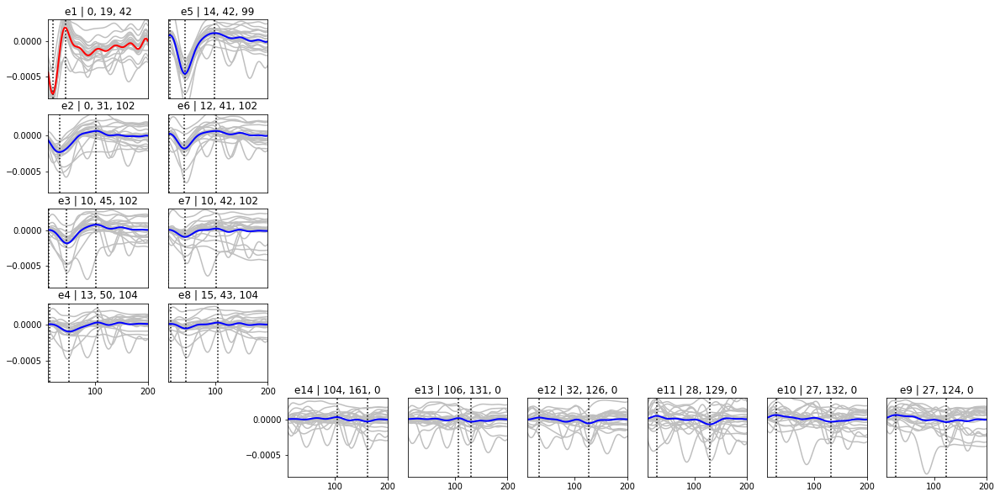

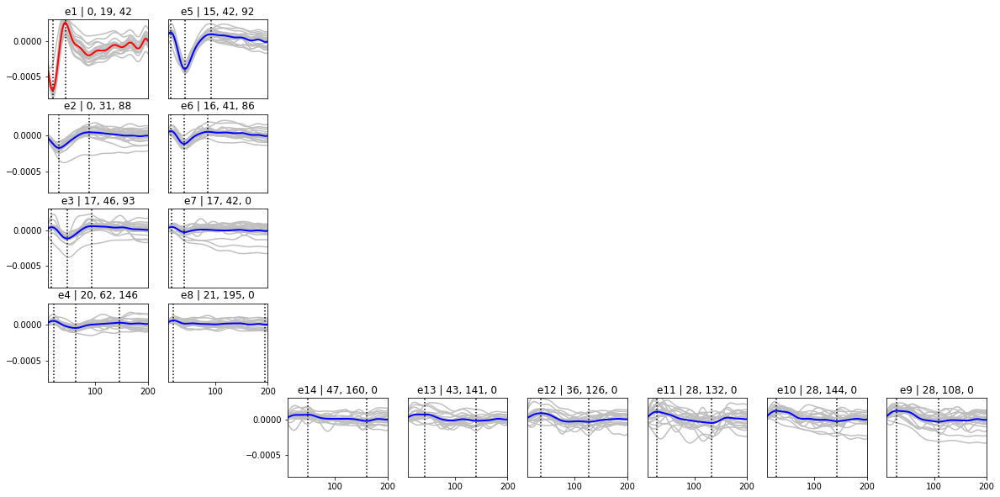

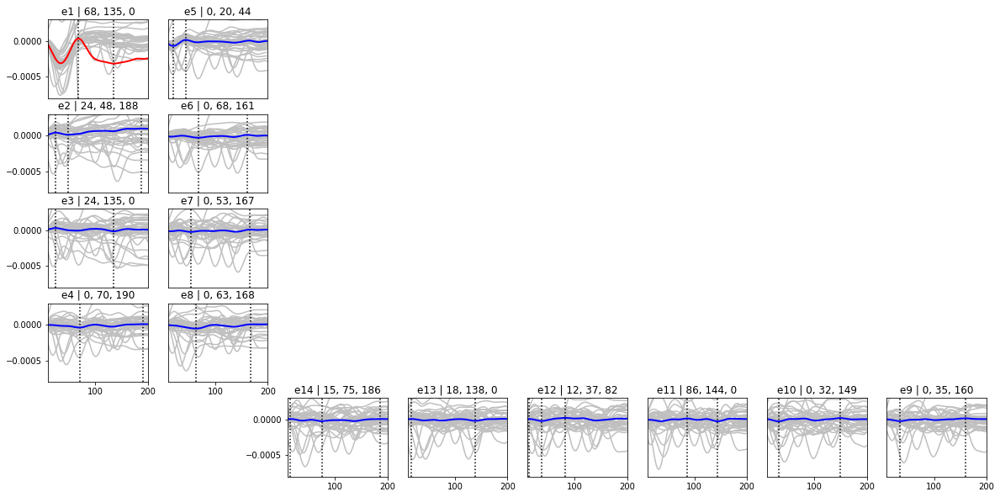

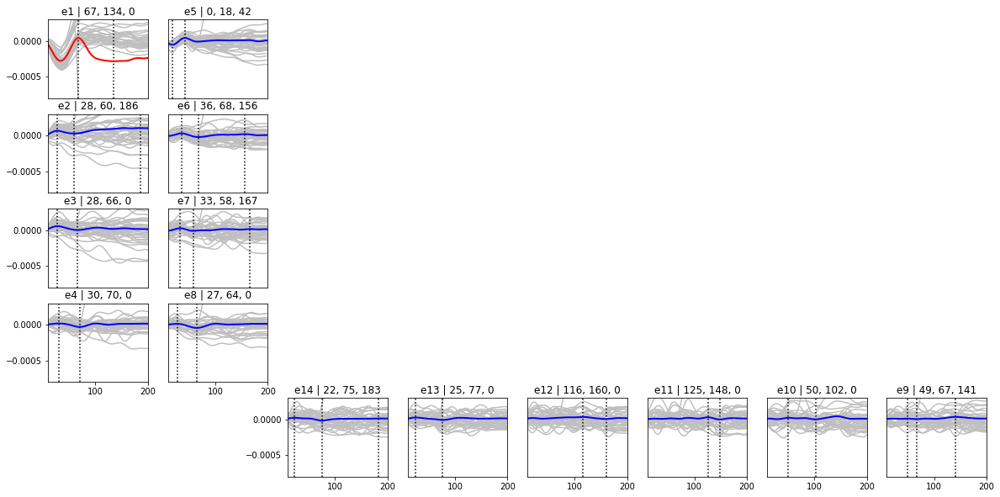

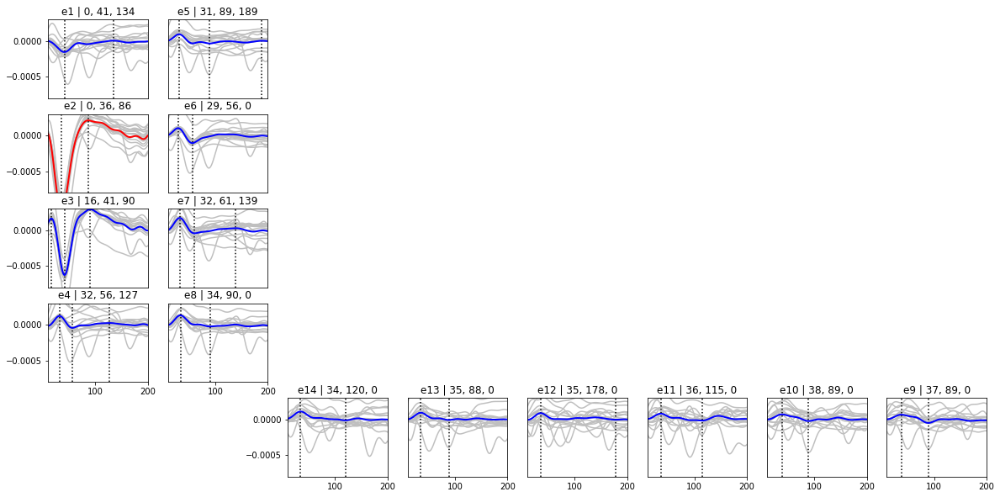

...

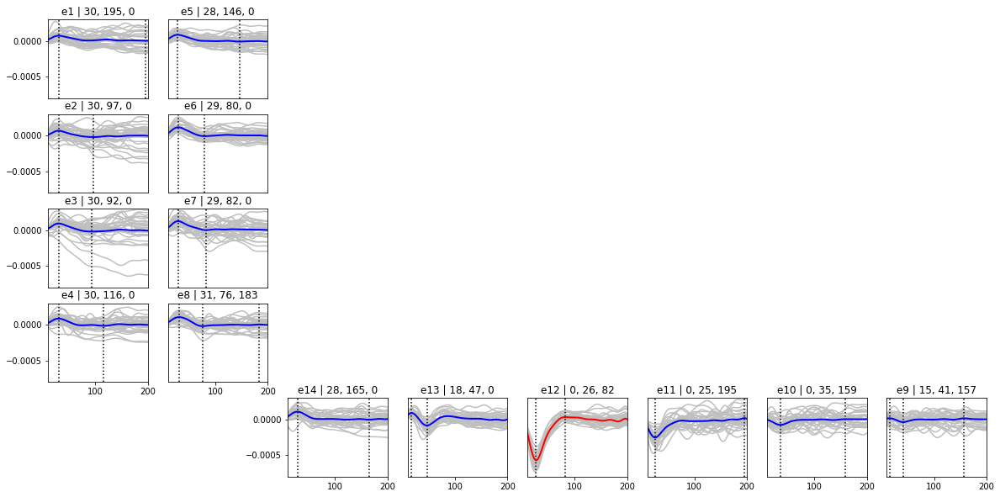

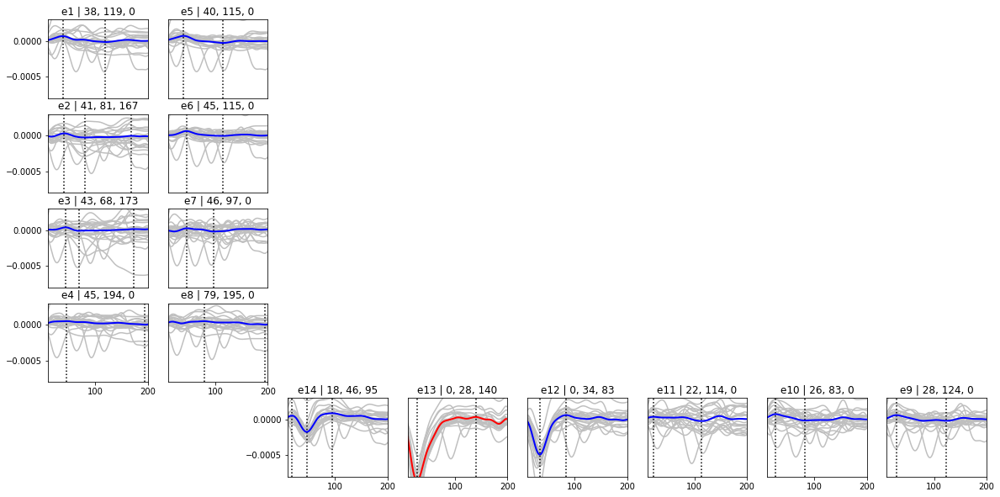

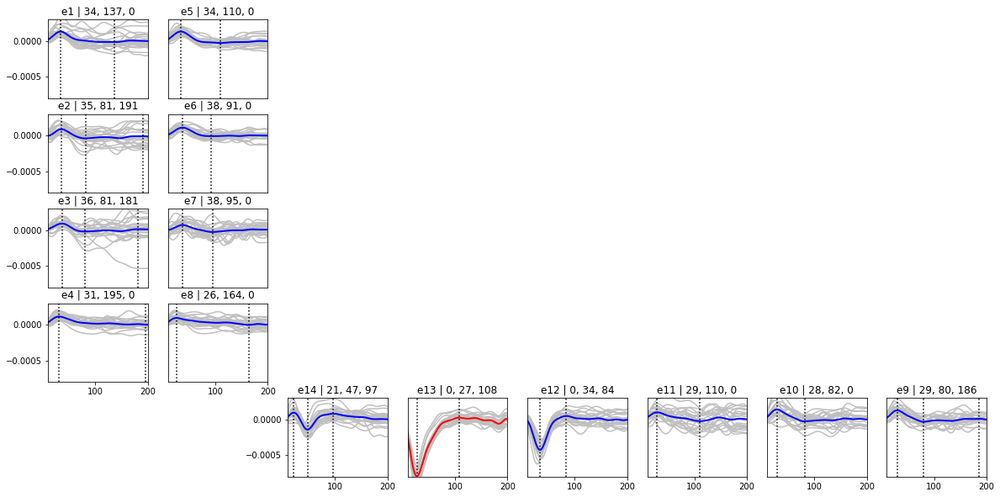

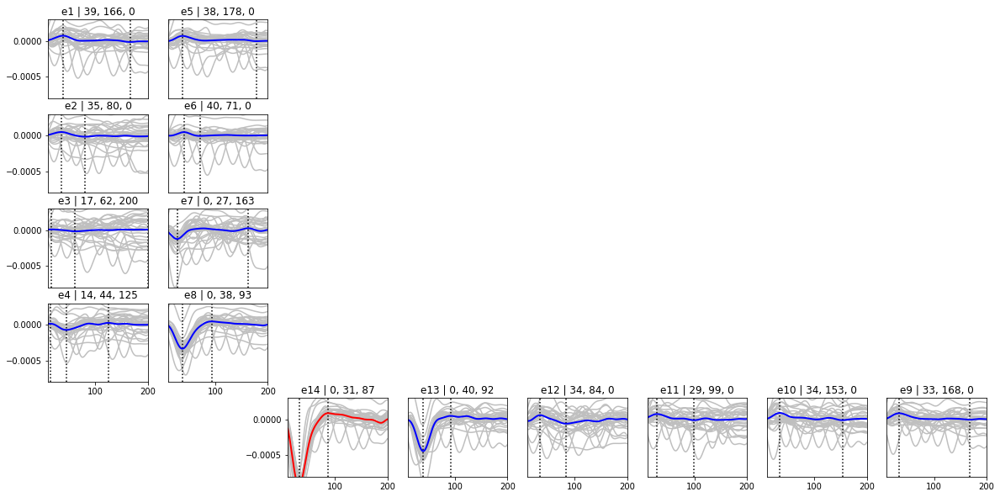

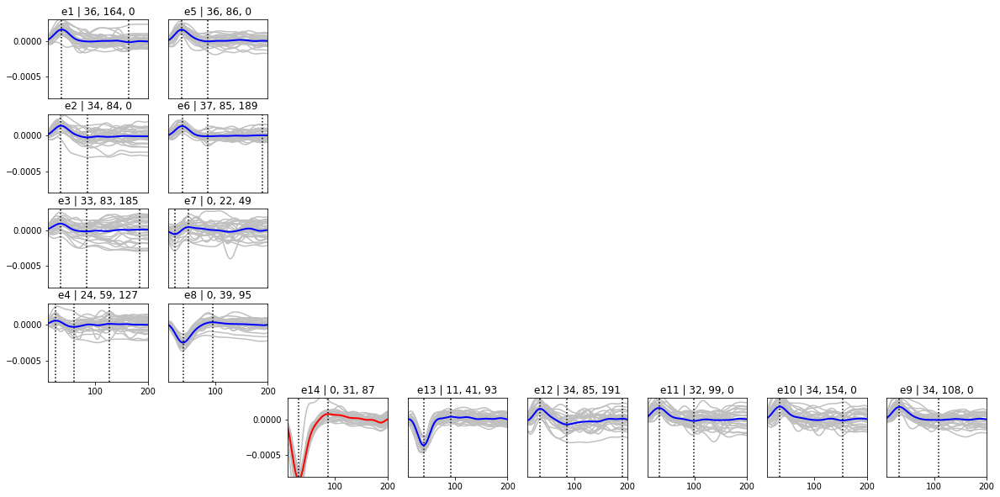

In [17]:
data_path = "/home/pfilipia/inria/chu_nice_inria/patients_ecog/patient01"
timestamp = "20180507_1240"

electrode_ids = np.arange(0, 14)
electrode_names = ['e1', 'e2', 'e3', 'e4', 'e5', 'e6', 'e7', 'e8', 'e9', 'e10', 'e11', 'e12', 'e13', 'e14']

subplot_rows = 5
subplot_cols = 8

subplot_ids = [
    1, 9, 17, 25, 
    2, 10, 18, 26, 
    40, 39, 38, 37, 36, 35
]

offset = 20

run(data_path, timestamp, electrode_ids, electrode_names, subplot_rows, subplot_cols, subplot_ids, offset)

# Patient #2

In [18]:
data_path = "/home/pfilipia/inria/chu_nice_inria/patients_ecog/patient02"
timestamp = "20180528_1213"

electrode_ids = np.arange(0, 15)
electrode_names = ['e1', 'e2', 'e3', 'e4', 'e5', 'e6', 'e7', 'e8', 'e9', 'e10', 'e11', 'e12', 'e13', 'e14', 'e15']

subplot_rows = 5
subplot_cols = 8

subplot_ids = [
    1, 9, 17, 25, 
    2, 10, 18, 26, 
    40, 39, 38, 37, 36, 35
]


offset = 25

run(data_path, timestamp, electrode_ids, electrode_names, subplot_rows, subplot_cols, subplot_ids, offset)

Extracting parameters from /home/pfilipia/inria/chu_nice_inria/patients_ecog/patient02/20180528_1213_brainvision.vhdr...


FileNotFoundError: [Errno 2] No such file or directory: '/home/pfilipia/inria/chu_nice_inria/patients_ecog/patient02/20180528_1213_brainvision.vhdr'

# Patient #3

Extracting parameters from /home/pfilipia/inria/chu_nice_inria/patients_ecog/patient03/20180801_1354_brainvision.vhdr...
Setting channel info structure...
Currently, 2 trigger(s) will be dropped, such as [sous cortical, S0]. Consider using ``event_id`` to parse triggers that do not follow the 'S###' pattern.


<ipython-input-4-1746d64c0cfa>:5: RuntimeWarning: Currently, 2 trigger(s) will be dropped, such as [sous cortical, S0]. Consider using ``event_id`` to parse triggers that do not follow the 'S###' pattern.
  vhdr_fname="%s_brainvision.vhdr" % data_file_prefix, montage=None


Creating RawArray with float64 data, n_channels=10, n_times=1514304
    Range : 0 ... 1514303 =      0.000 ...   739.406 secs
Ready.
Setting up band-pass filter from 0.5 - 1e+03 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 24.0 Hz
Filter length of 13517 samples (6.600 sec) selected
Creating RawArray with float64 data, n_channels=10, n_times=1514304
    Range : 0 ... 1514303 =      0.000 ...   739.406 secs
Ready.
Creating RawArray with float64 data, n_channels=10, n_times=1514304
    Range : 0 ... 1514303 =      0.000 ...   739.406 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
30 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 30 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=10, 

l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
29 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 29 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=10, n_times=1514304
    Range : 0 ... 1514303 =      0.000 ...   739.406 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
31 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 31 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=10, n_times=1514304
    Range : 0 ... 1514303 =      0.000 ...   739.406 secs
Ready.
Setting up band-pass filter from 0.

/home/patrykfi/anaconda3/envs/mne/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Creating RawArray with float64 data, n_channels=10, n_times=1514304
    Range : 0 ... 1514303 =      0.000 ...   739.406 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
17 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 17 events and 1024 original time points ...
0 bad epochs dropped


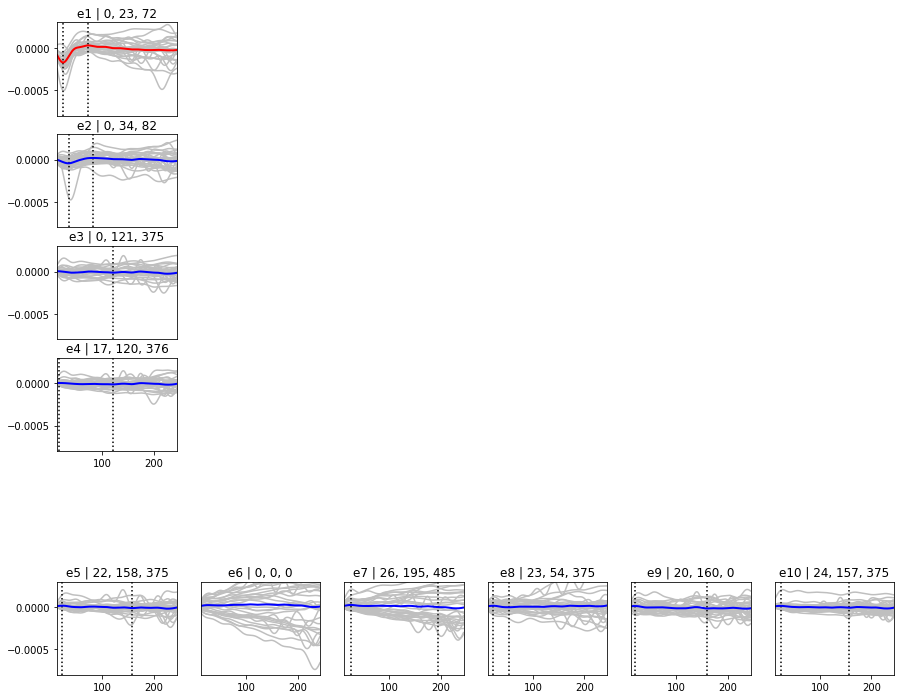

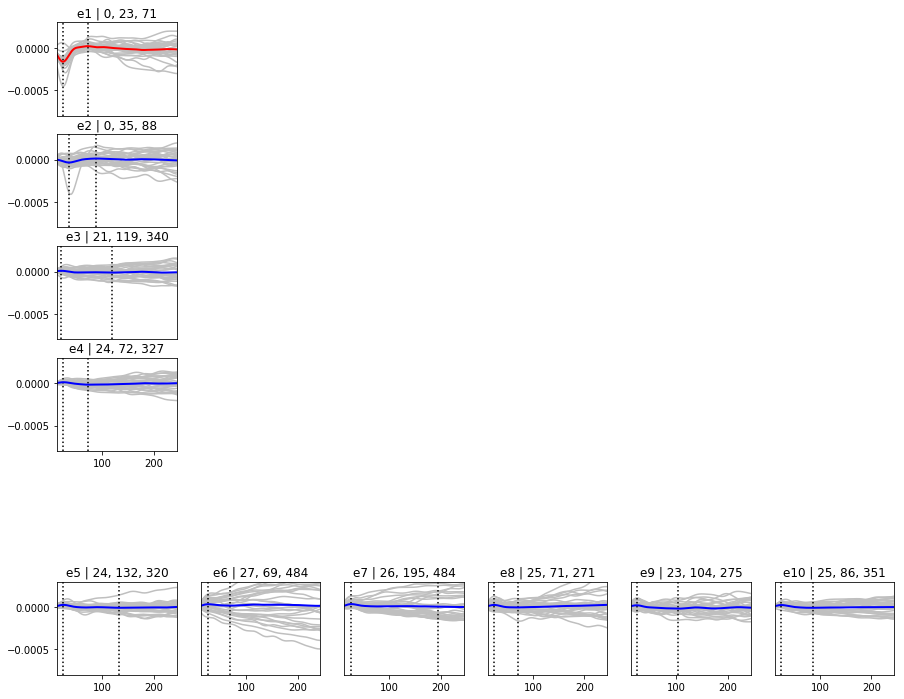

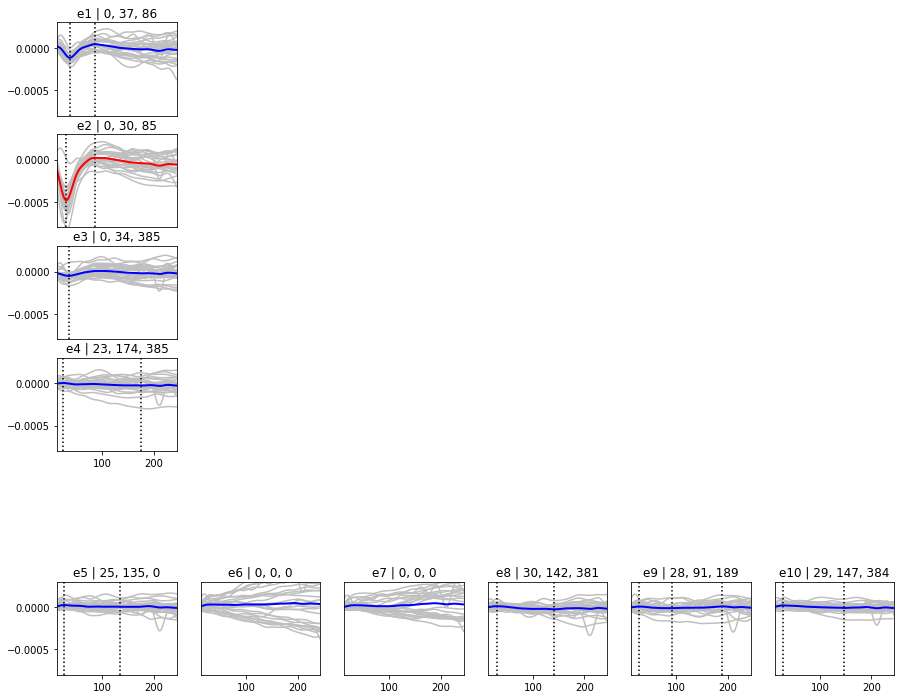

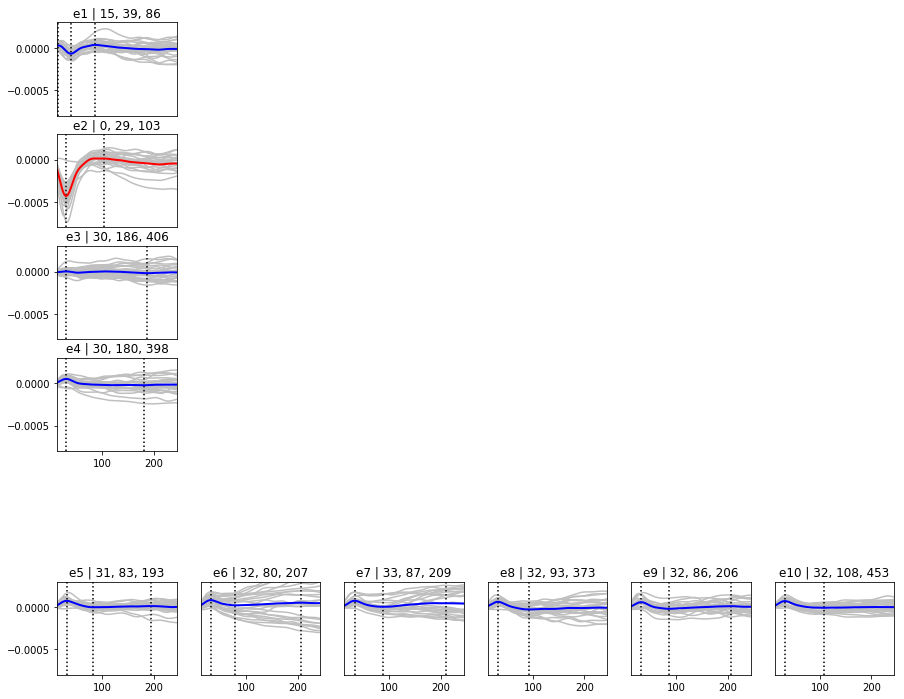

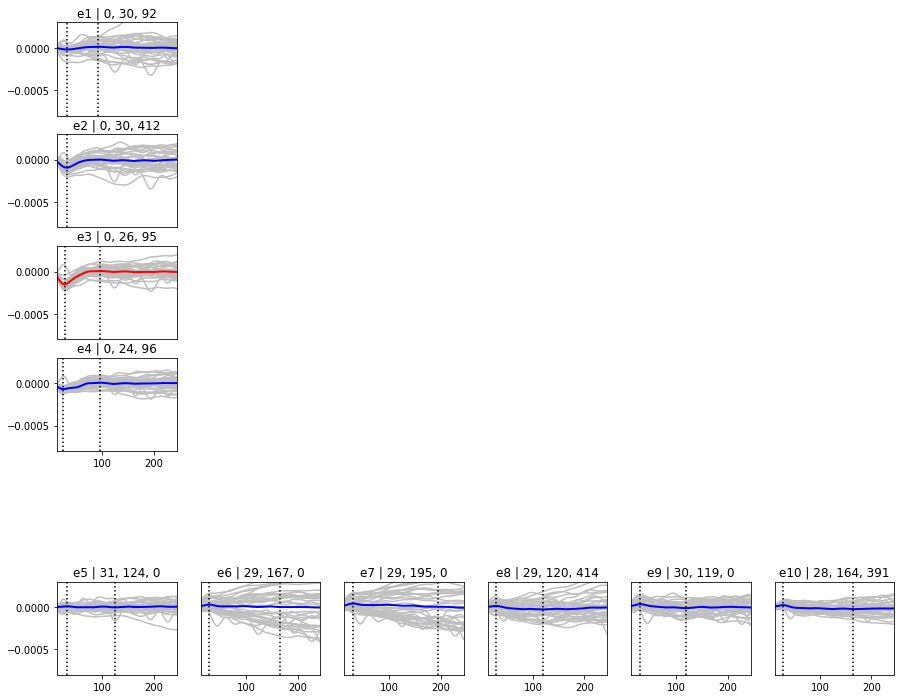

...

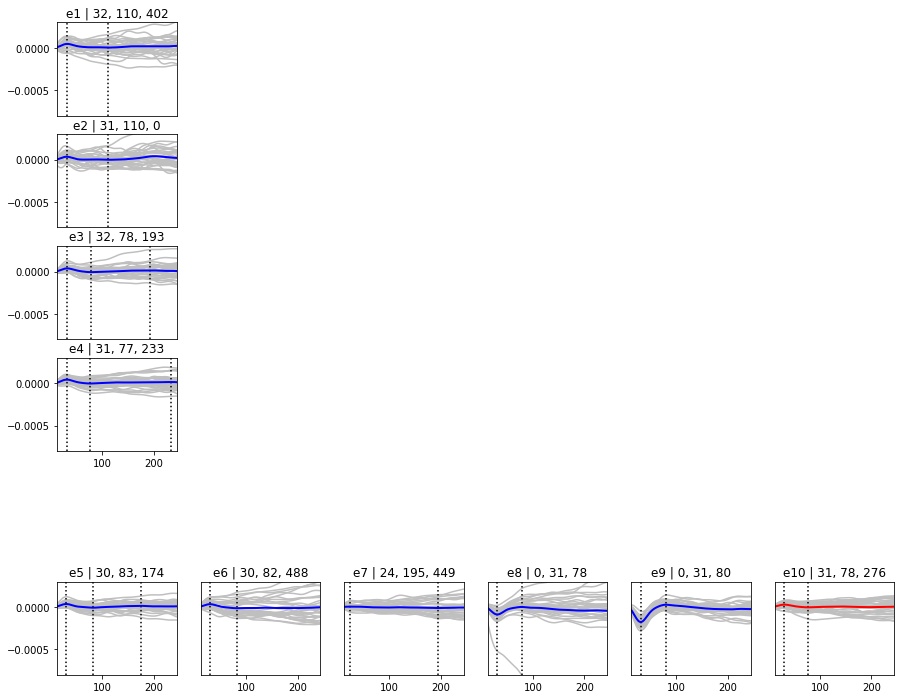

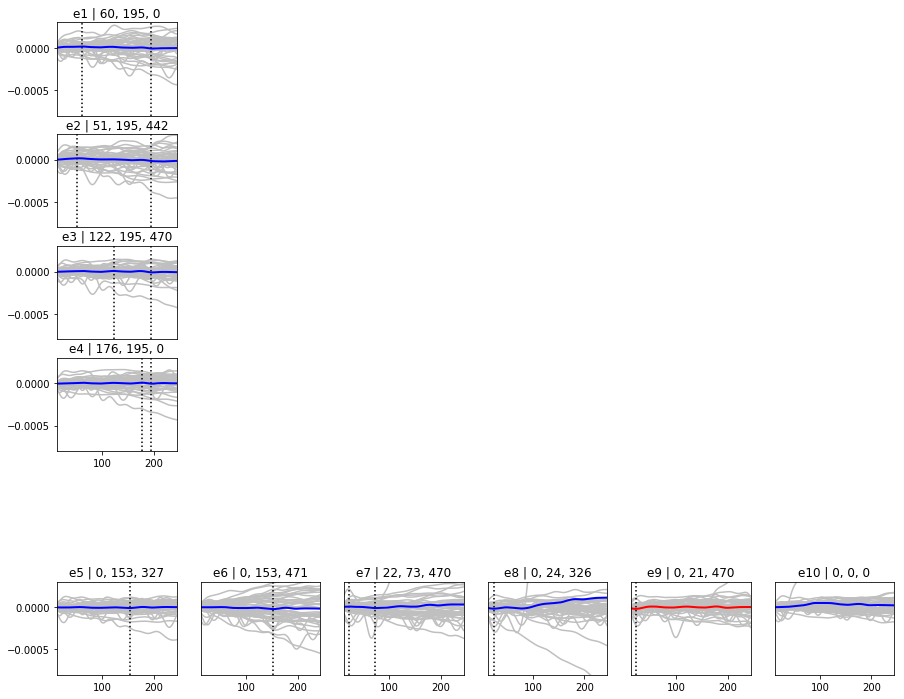

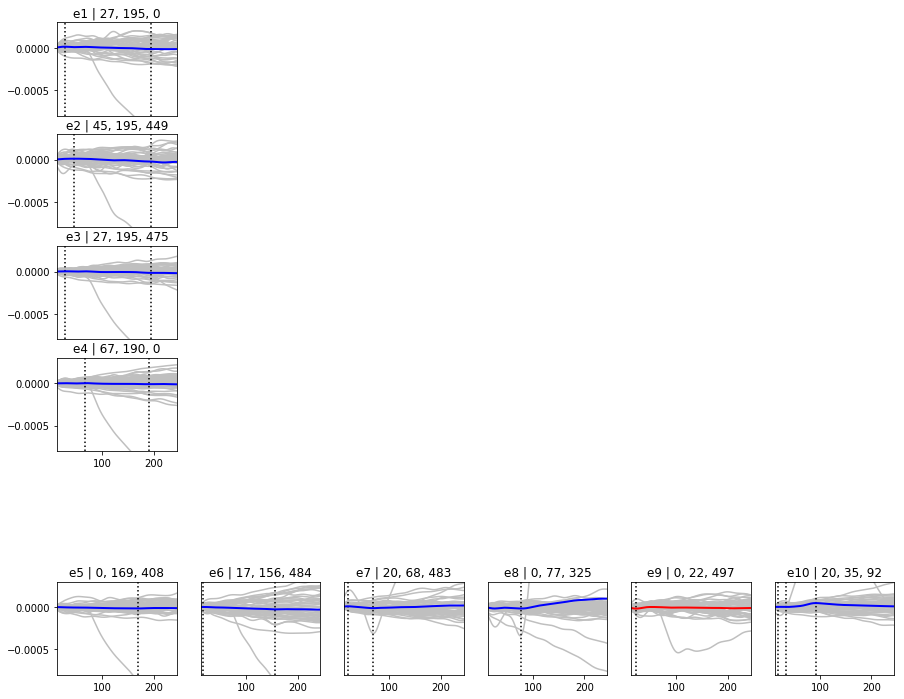

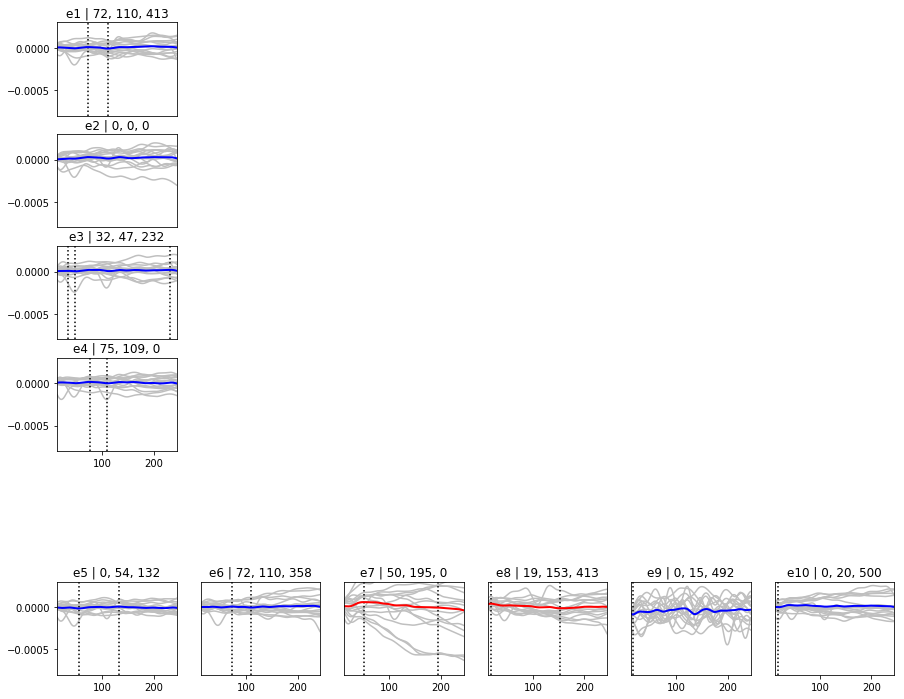

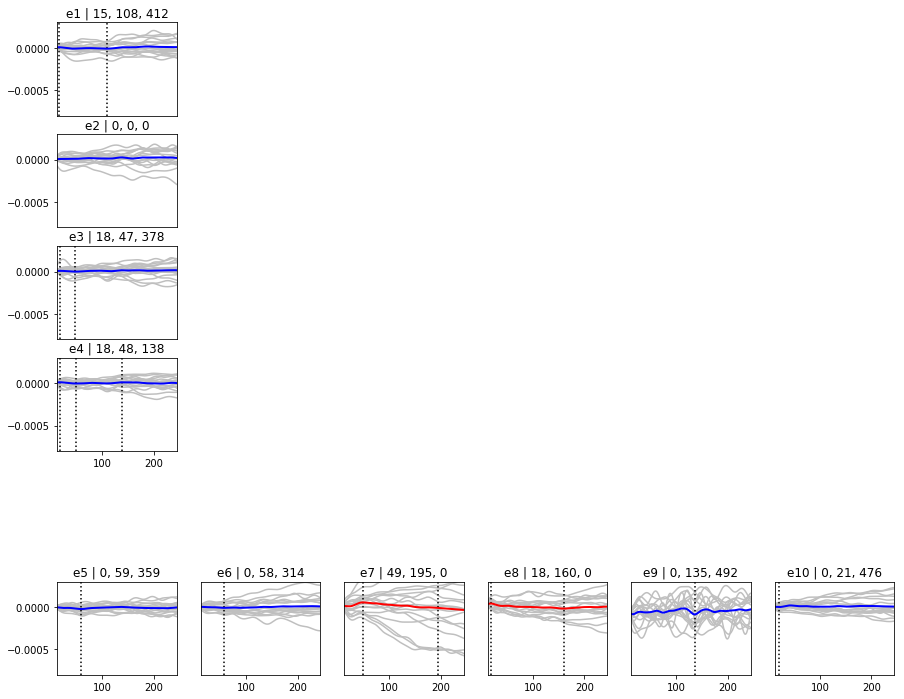

In [19]:
data_path = "/home/pfilipia/inria/chu_nice_inria/patients_ecog/patient03"
timestamp = "20180801_1354"

electrode_ids = [0, 1, 2, 3, 8, 9, 10, 11, 12, 13]
electrode_names = ['e1', 'e2', 'e3', 'e4', 'e5', 'e6', 'e7', 'e8', 'e9', 'e10']

subplot_rows = 6
subplot_cols = 6

subplot_ids = [
    1, 7, 13, 19, 
    31, 32, 33, 34, 35, 36
]

offset = 25

run(data_path, timestamp, electrode_ids, electrode_names, subplot_rows, subplot_cols, subplot_ids, offset)

# Patient #4

Extracting parameters from /home/pfilipia/inria/chu_nice_inria/patients_ecog/patient04/20180806_1240_brainvision.vhdr...
Setting channel info structure...
Currently, 2 trigger(s) will be dropped, such as [Impedance, S0]. Consider using ``event_id`` to parse triggers that do not follow the 'S###' pattern.


<ipython-input-4-1746d64c0cfa>:5: RuntimeWarning: Currently, 2 trigger(s) will be dropped, such as [Impedance, S0]. Consider using ``event_id`` to parse triggers that do not follow the 'S###' pattern.
  vhdr_fname="%s_brainvision.vhdr" % data_file_prefix, montage=None


Creating RawArray with float64 data, n_channels=14, n_times=1622756
    Range : 0 ... 1622755 =      0.000 ...   792.361 secs
Ready.
Setting up band-pass filter from 0.5 - 1e+03 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 24.0 Hz
Filter length of 13517 samples (6.600 sec) selected
Creating RawArray with float64 data, n_channels=14, n_times=1622756
    Range : 0 ... 1622755 =      0.000 ...   792.361 secs
Ready.
Creating RawArray with float64 data, n_channels=14, n_times=1622756
    Range : 0 ... 1622755 =      0.000 ...   792.361 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
18 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 18 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=14, 

l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
24 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 24 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=14, n_times=1622756
    Range : 0 ... 1622755 =      0.000 ...   792.361 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
24 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 24 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=14, n_times=1622756
    Range : 0 ... 1622755 =      0.000 ...   792.361 secs
Ready.
Setting up band-pass filter from 0.

/home/patrykfi/anaconda3/envs/mne/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Creating RawArray with float64 data, n_channels=14, n_times=1622756
    Range : 0 ... 1622755 =      0.000 ...   792.361 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
23 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 23 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=14, n_times=1622756
    Range : 0 ... 1622755 =      0.000 ...   792.361 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
25 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 25 events and 1024 original time points ...
0 bad epoch

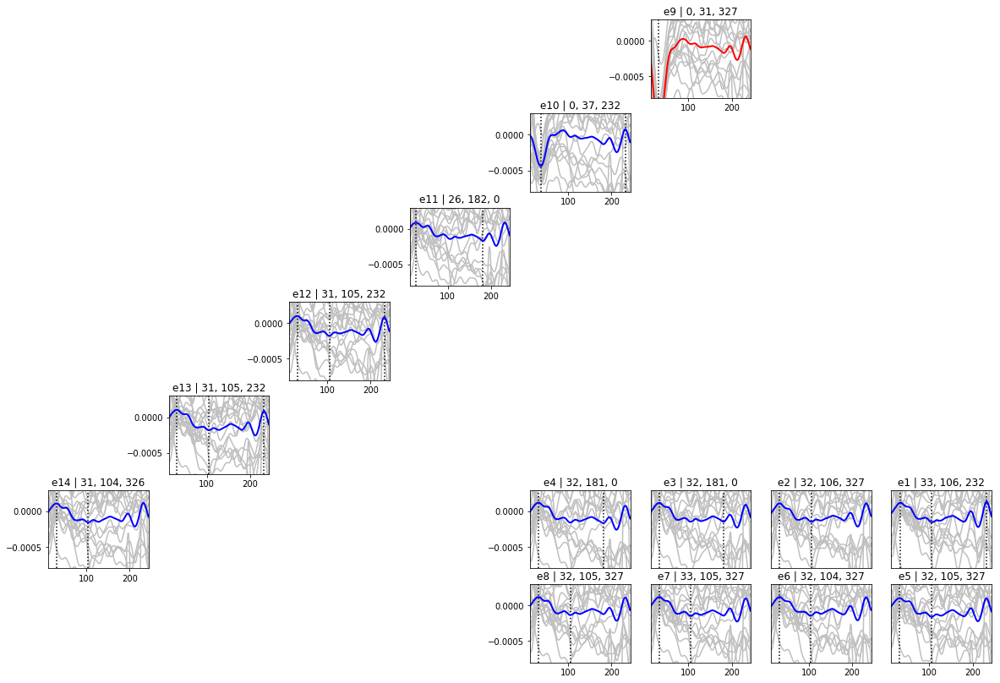

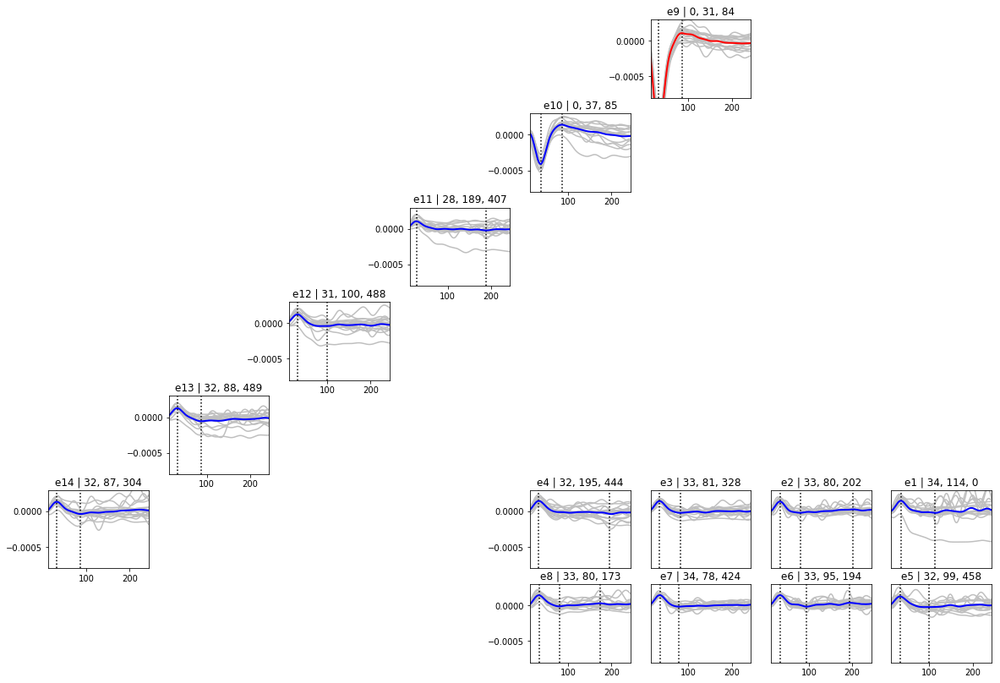

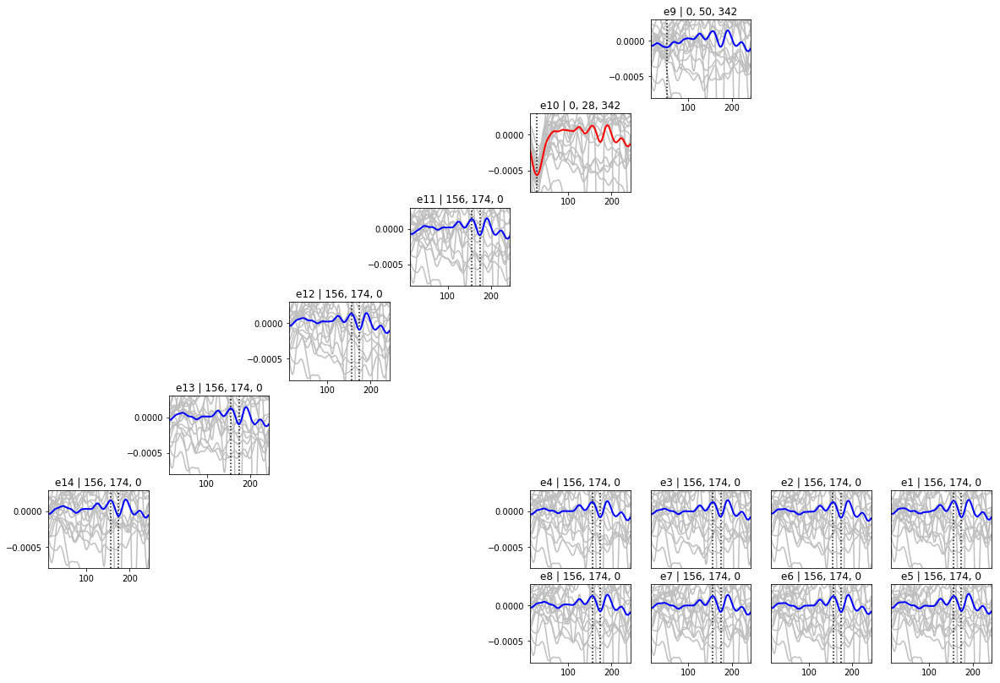

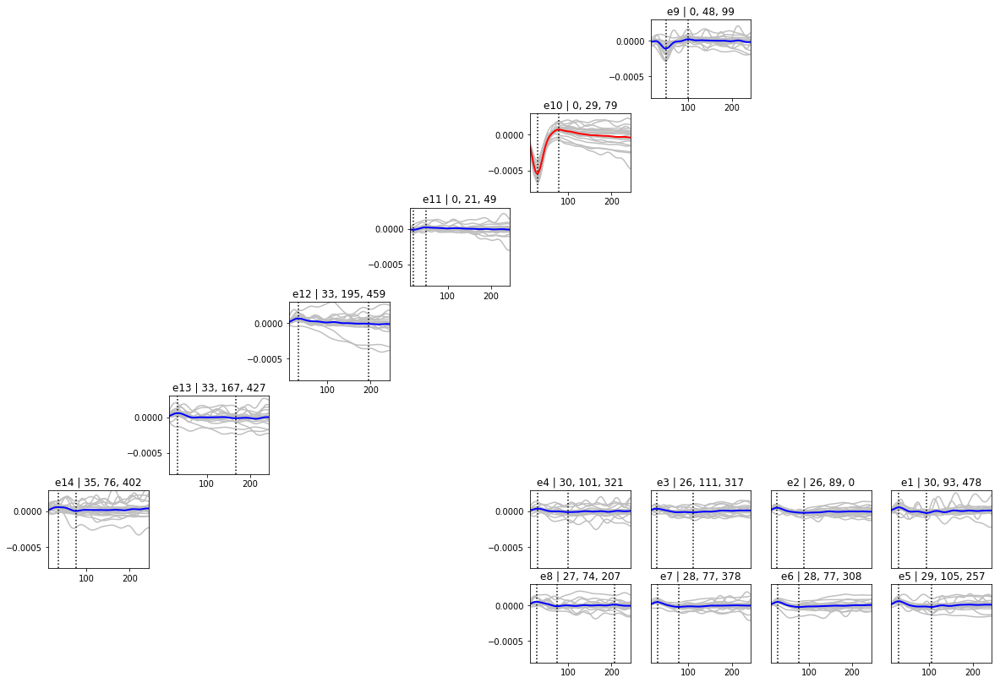

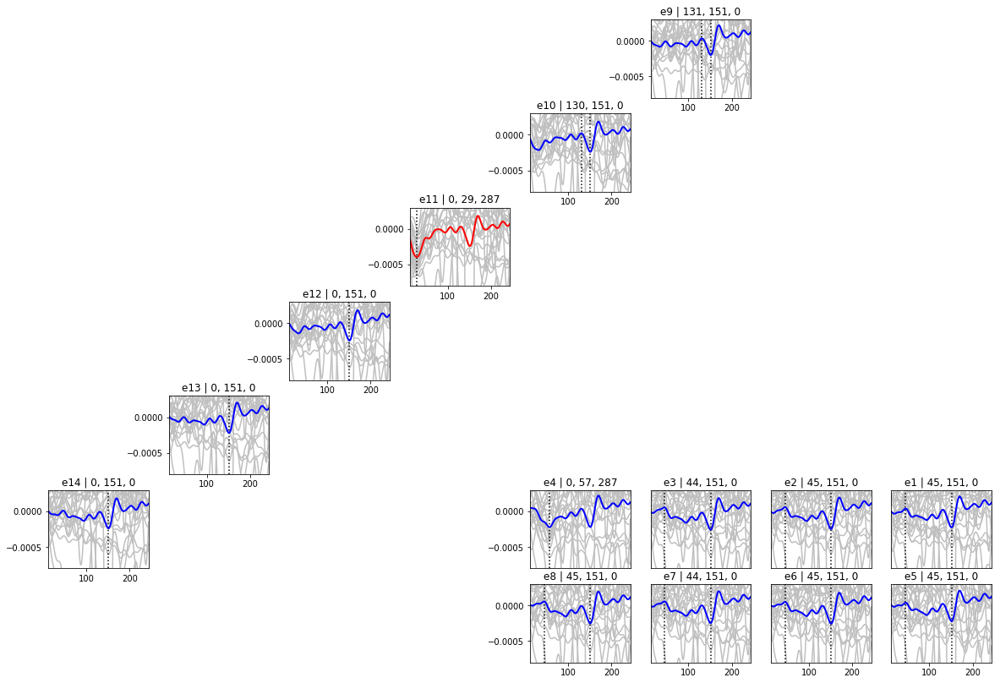

...

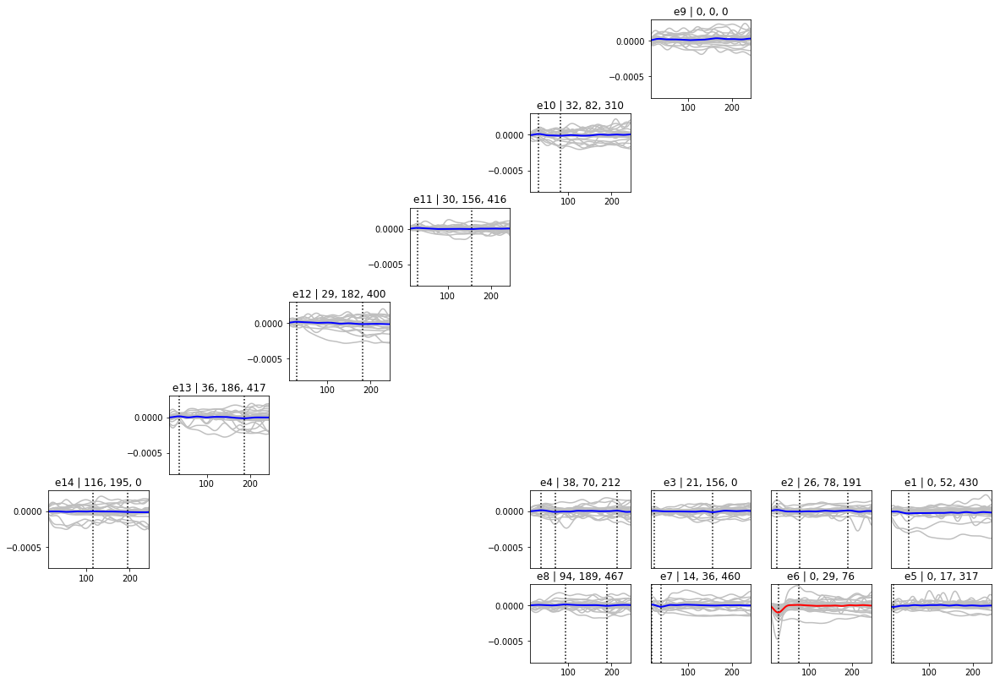

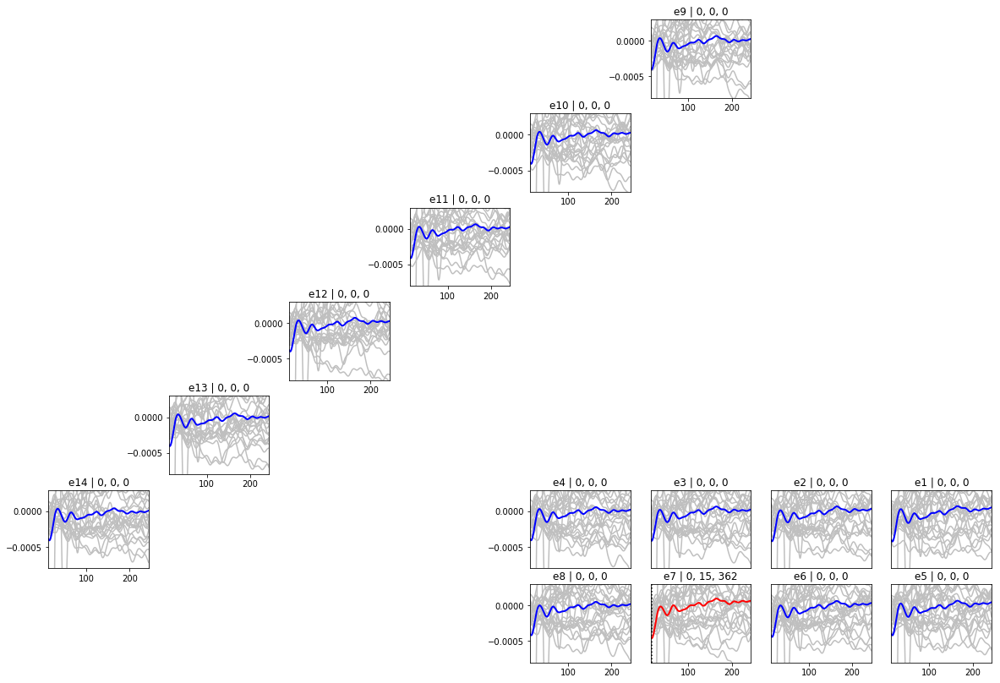

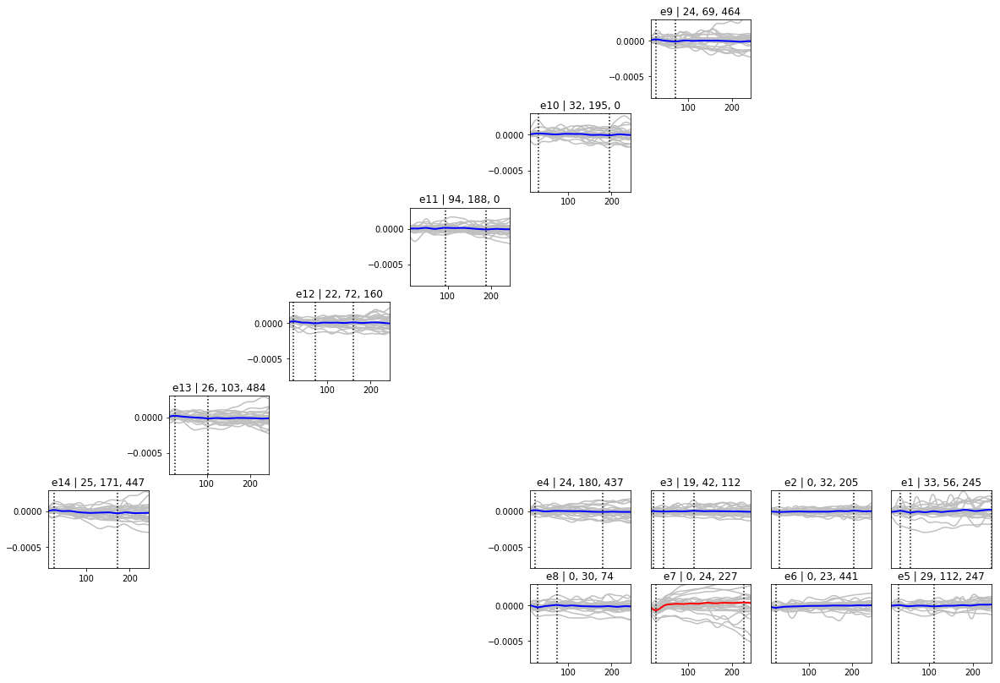

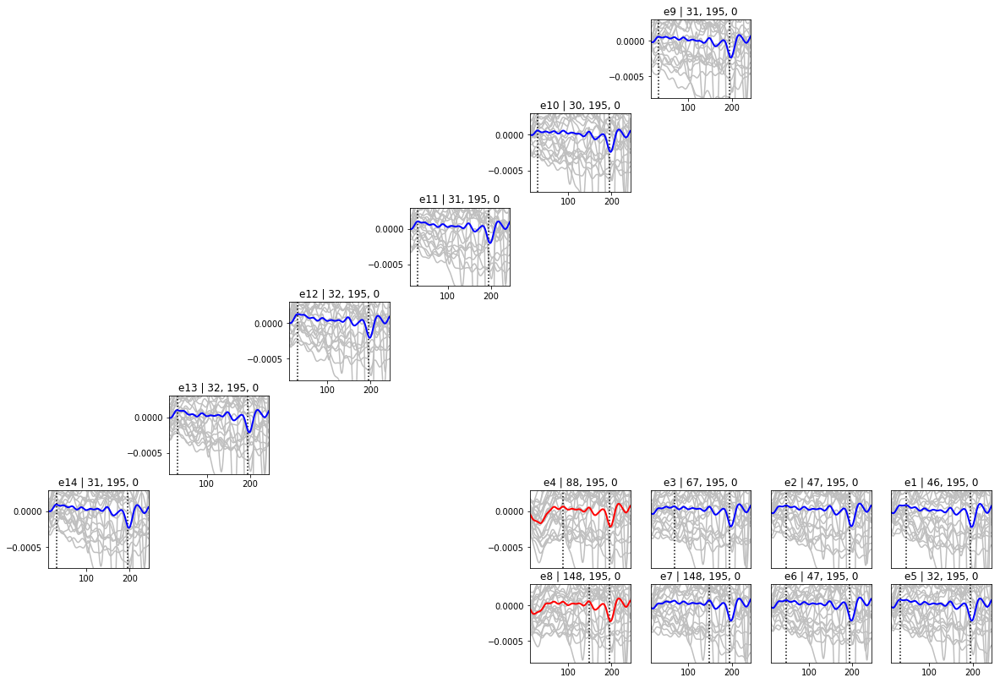

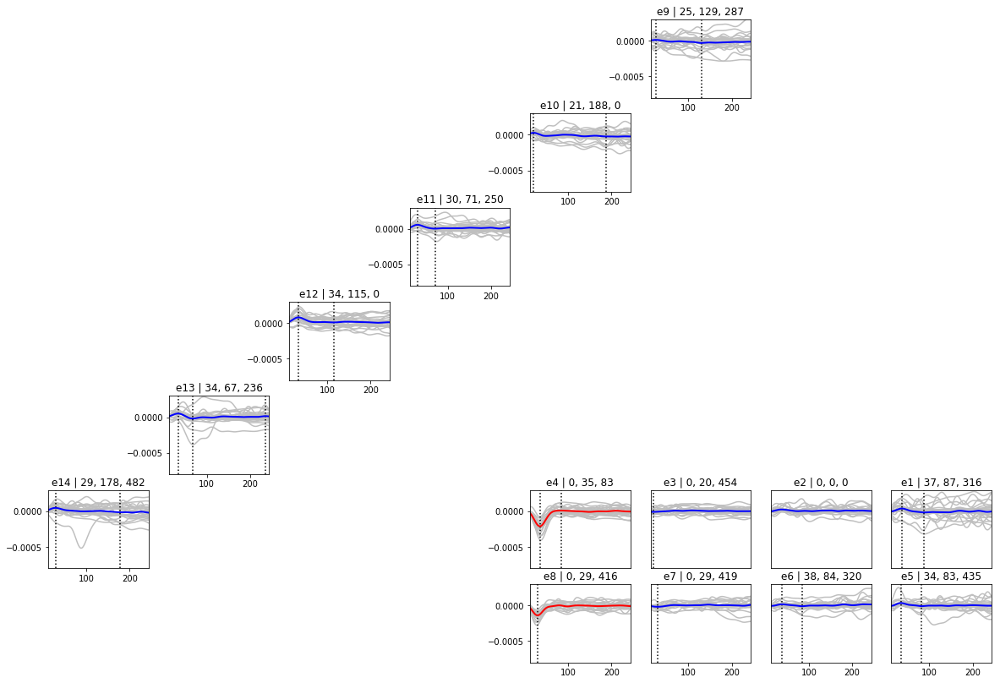

In [20]:
data_path = "/home/pfilipia/inria/chu_nice_inria/patients_ecog/patient04"
timestamp = "20180806_1240"

electrode_ids = np.arange(0, 14)
electrode_names = ['e1', 'e2', 'e3', 'e4', 'e5', 'e6', 'e7', 'e8', 'e9', 'e10', 'e12', 'e13', 'e14', 'e11']

subplot_rows = 7
subplot_cols = 8

subplot_ids = [
    48, 47, 46, 45, 
    56, 55, 54, 53,
    6, 13, 27, 34, 41, 20
]

offset = 25

run(data_path, timestamp, electrode_ids, electrode_names, subplot_rows, subplot_cols, subplot_ids, offset)

# Patient #6

Extracting parameters from /home/pfilipia/inria/chu_nice_inria/patients_ecog/patient06/20181126_1225_brainvision.vhdr...
Setting channel info structure...
Currently, 2 trigger(s) will be dropped, such as [Stim off, Test]. Consider using ``event_id`` to parse triggers that do not follow the 'S###' pattern.


<ipython-input-5-1746d64c0cfa>:5: RuntimeWarning: Currently, 2 trigger(s) will be dropped, such as [Stim off, Test]. Consider using ``event_id`` to parse triggers that do not follow the 'S###' pattern.
  vhdr_fname="%s_brainvision.vhdr" % data_file_prefix, montage=None


Creating RawArray with float64 data, n_channels=14, n_times=1630441
    Range : 0 ... 1630440 =      0.000 ...   796.113 secs
Ready.
Setting up band-pass filter from 0.5 - 1e+03 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 24.0 Hz
Filter length of 13517 samples (6.600 sec) selected
s1
14 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 14 events and 1024 original time points ...
0 bad epochs dropped
e1: first down
e2: first down
e3: first down
e4: first down
e5: first down
e6: first up
e7: unknown
e8: first down
e9: first down
e10: first down
e12: first down
e13: first down
e14: first down
e11: first down
s1
18 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 18 events and 1024 original time points ...
0 bad epochs dropped
e1: first down
e2: first down
e3: first down
e4: first down
e5: first down
e

/home/patrykfi/anaconda3/envs/mne/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


20 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 20 events and 1024 original time points ...
0 bad epochs dropped
e1: first down
e2: first down
e3: first down
e4: first down
e5: first down
e6: first down
e7: first down
e8: first down
e9: first down
e10: first down
e12: first up
e13: first up
e14: unknown
e11: first down
s2
17 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 17 events and 1024 original time points ...
0 bad epochs dropped
e1: unknown
e2: unknown
e3: unknown
e4: unknown
e5: unknown
e6: first up
e7: unknown
e8: unknown
e9: unknown
e10: unknown
e12: first down
e13: first down
e14: first down
e11: first down
s3
20 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 20 events and 1024 original time points ...
0 bad epochs dropped
e1:

ValueError: zero-size array to reduction operation minimum which has no identity

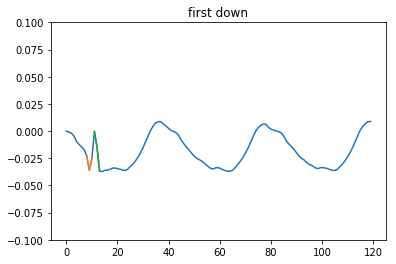

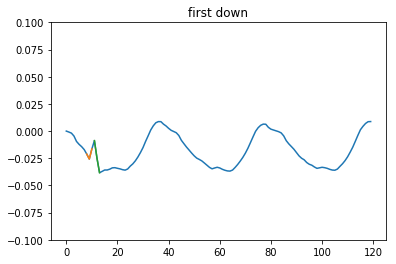

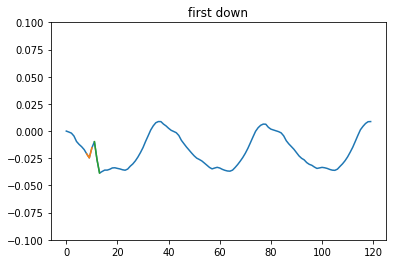

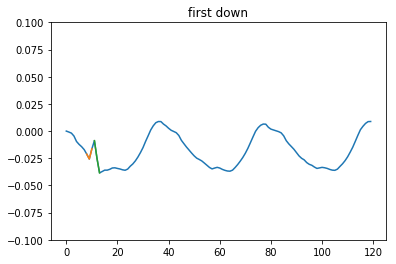

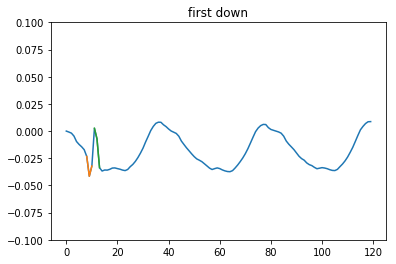

...

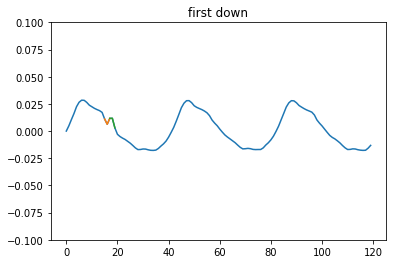

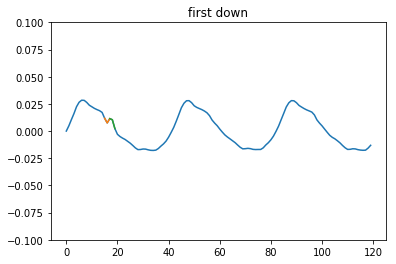

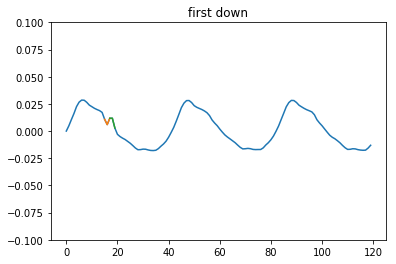

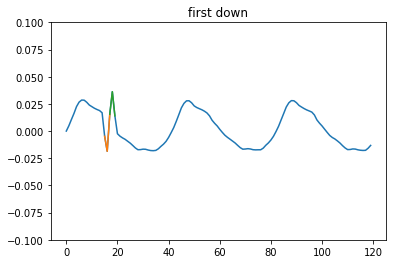

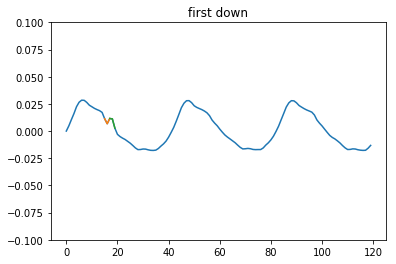

In [73]:
data_path = "/home/pfilipia/inria/chu_nice_inria/patients_ecog/patient06"
timestamp = "20181126_1225"

electrode_ids = np.arange(0, 14)
electrode_names = ['e1', 'e2', 'e3', 'e4', 'e5', 'e6', 'e7', 'e8', 'e9', 'e10', 'e12', 'e13', 'e14', 'e11']

subplot_rows = 5
subplot_cols = 6

subplot_ids = [
    23, 17, 11,  5, 
    22, 16, 10,  4, 
    30, 29, 27, 26, 25, 28
]

offset = 20

run(data_path, timestamp, electrode_ids, electrode_names, subplot_rows, subplot_cols, subplot_ids, offset)

# Patient #7

Extracting parameters from /home/pfilipia/inria/chu_nice_inria/patients_ecog/patient07/20180917_1327_brainvision.vhdr...
Setting channel info structure...
Currently, 1 trigger(s) will be dropped, such as [S0]. Consider using ``event_id`` to parse triggers that do not follow the 'S###' pattern.


<ipython-input-4-1746d64c0cfa>:5: RuntimeWarning: Currently, 1 trigger(s) will be dropped, such as [S0]. Consider using ``event_id`` to parse triggers that do not follow the 'S###' pattern.
  vhdr_fname="%s_brainvision.vhdr" % data_file_prefix, montage=None


Creating RawArray with float64 data, n_channels=14, n_times=1196035
    Range : 0 ... 1196034 =      0.000 ...   584.001 secs
Ready.
Setting up band-pass filter from 0.5 - 1e+03 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 24.0 Hz
Filter length of 13517 samples (6.600 sec) selected
Creating RawArray with float64 data, n_channels=14, n_times=1196035
    Range : 0 ... 1196034 =      0.000 ...   584.001 secs
Ready.
Creating RawArray with float64 data, n_channels=14, n_times=1196035
    Range : 0 ... 1196034 =      0.000 ...   584.001 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
21 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 21 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=14, 

l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
19 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 19 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=14, n_times=1196035
    Range : 0 ... 1196034 =      0.000 ...   584.001 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
22 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 22 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=14, n_times=1196035
    Range : 0 ... 1196034 =      0.000 ...   584.001 secs
Ready.
Setting up band-pass filter from 0.

/home/patrykfi/anaconda3/envs/mne/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Creating RawArray with float64 data, n_channels=14, n_times=1196035
    Range : 0 ... 1196034 =      0.000 ...   584.001 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
22 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 22 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=14, n_times=1196035
    Range : 0 ... 1196034 =      0.000 ...   584.001 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
39 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 39 events and 1024 original time points ...
0 bad epoch

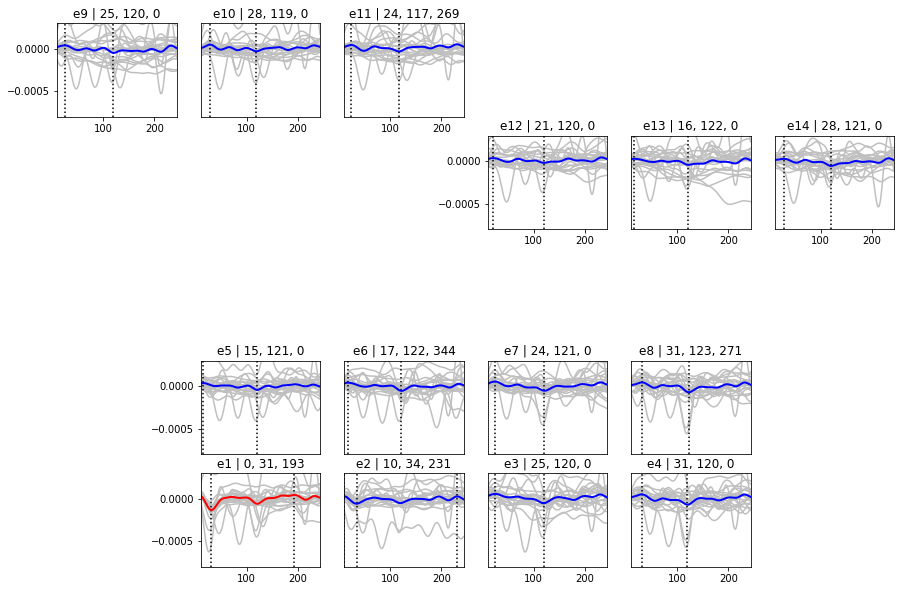

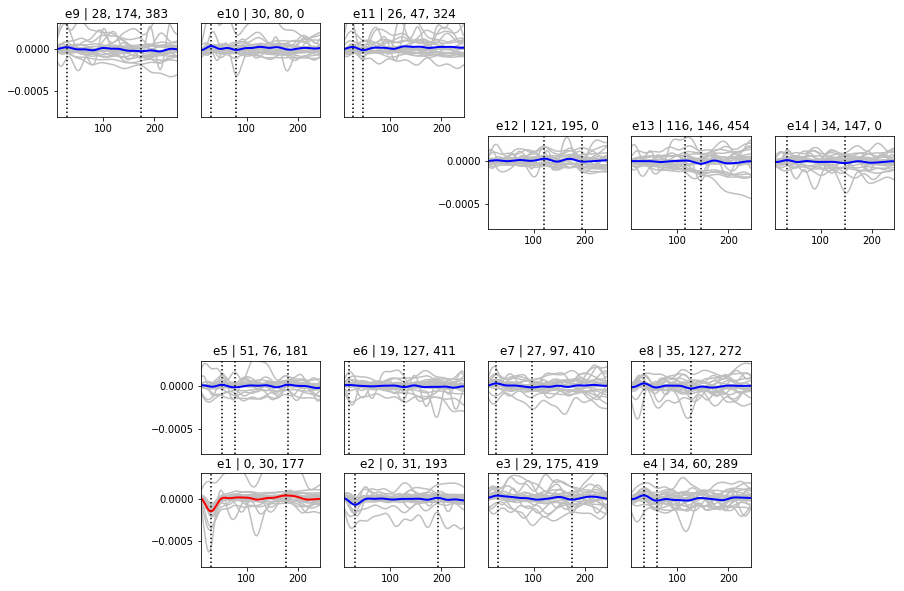

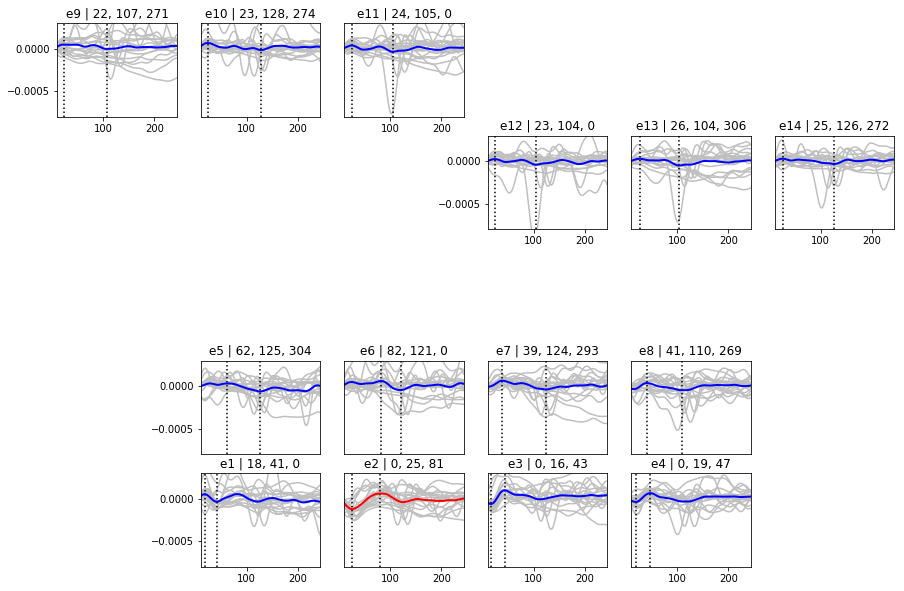

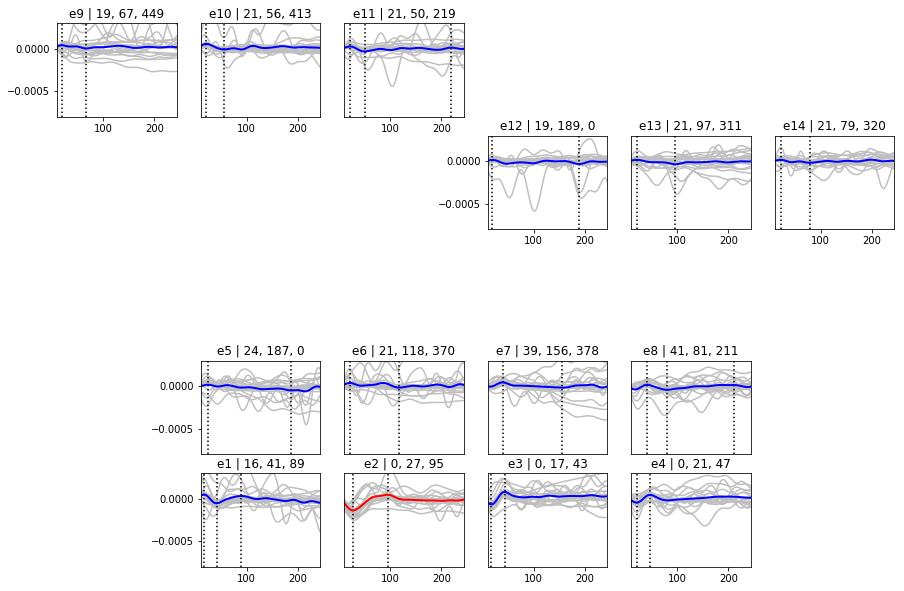

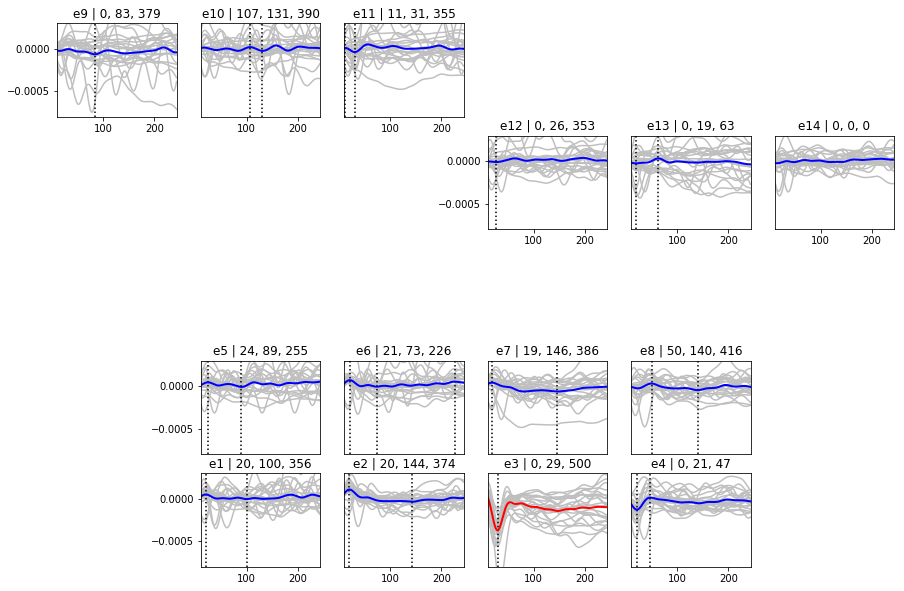

...

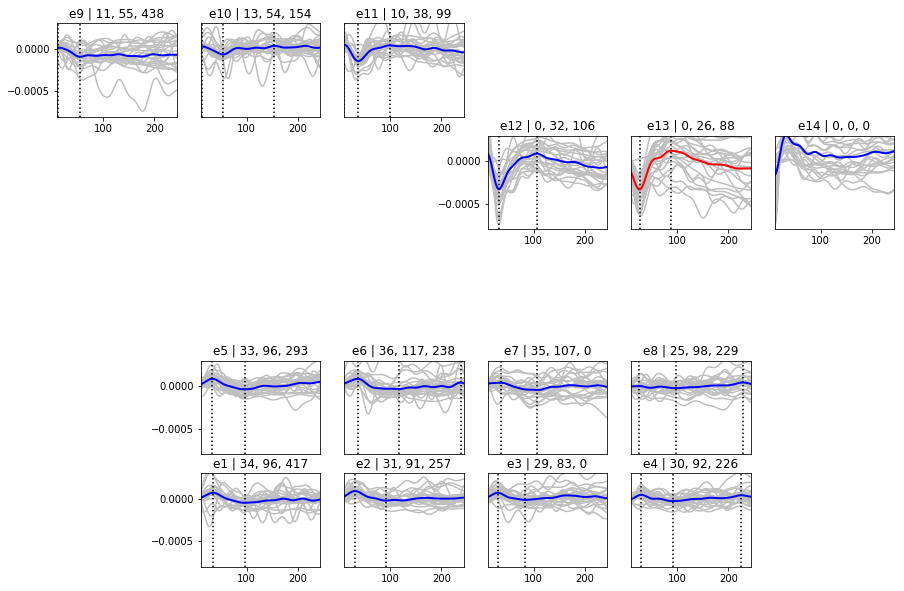

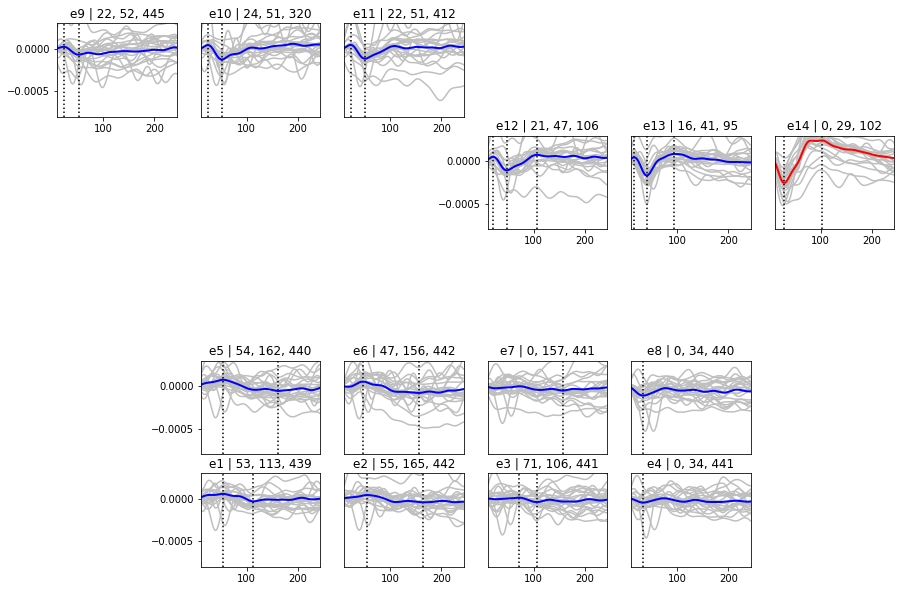

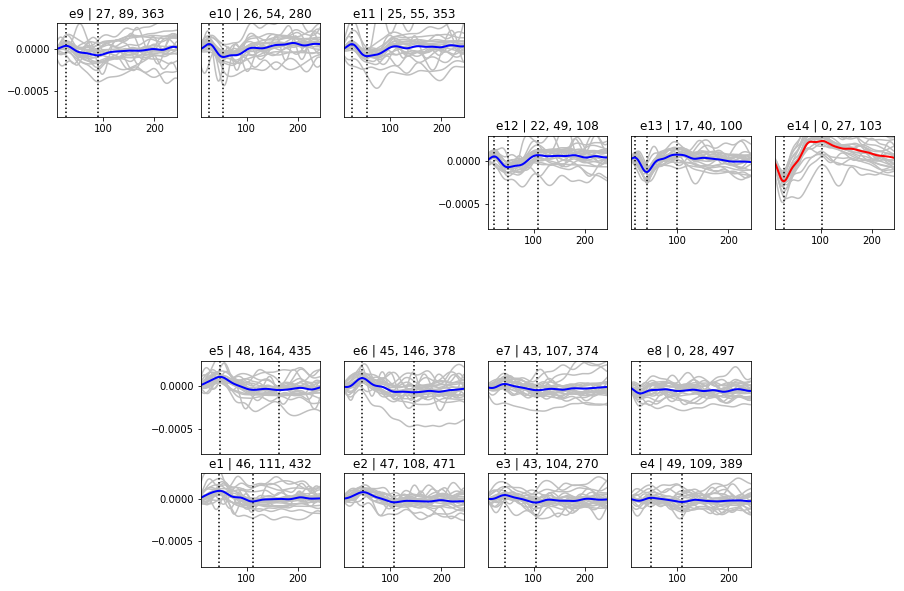

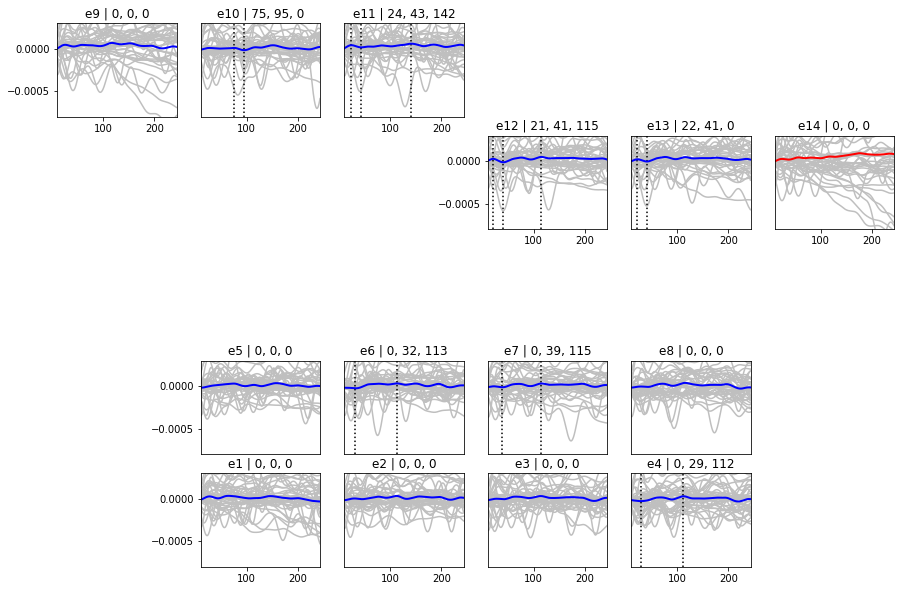

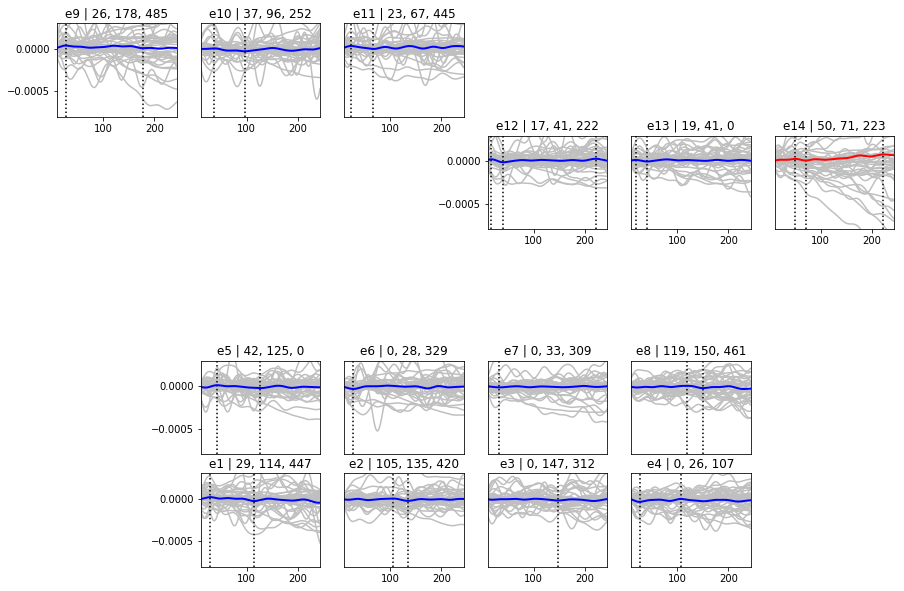

In [21]:
data_path = "/home/pfilipia/inria/chu_nice_inria/patients_ecog/patient07"
timestamp = "20180917_1327"

electrode_ids = np.arange(0, 14)
electrode_names = ['e1', 'e2', 'e3', 'e4', 'e5', 'e6', 'e7', 'e8', 'e9', 'e10', 'e12', 'e13', 'e14', 'e11']

subplot_rows = 5
subplot_cols = 6

subplot_ids = [
    26, 27, 28, 29, 
    20, 21, 22, 23,
    1, 2, 10, 11, 12, 3
]

offset = 20

run(data_path, timestamp, electrode_ids, electrode_names, subplot_rows, subplot_cols, subplot_ids, offset)

# Patient #8

Extracting parameters from /home/pfilipia/inria/chu_nice_inria/patients_ecog/patient08/20181120_1207_brainvision.vhdr...
Setting channel info structure...
Currently, 3 trigger(s) will be dropped, such as [S0 -, S0 el 1 sham, S0]. Consider using ``event_id`` to parse triggers that do not follow the 'S###' pattern.


<ipython-input-4-1746d64c0cfa>:5: RuntimeWarning: Currently, 3 trigger(s) will be dropped, such as [S0 -, S0 el 1 sham, S0]. Consider using ``event_id`` to parse triggers that do not follow the 'S###' pattern.
  vhdr_fname="%s_brainvision.vhdr" % data_file_prefix, montage=None


Creating RawArray with float64 data, n_channels=8, n_times=1881588
    Range : 0 ... 1881587 =      0.000 ...   918.744 secs
Ready.
Setting up band-pass filter from 0.5 - 1e+03 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 24.0 Hz
Filter length of 13517 samples (6.600 sec) selected
Creating RawArray with float64 data, n_channels=8, n_times=1881588
    Range : 0 ... 1881587 =      0.000 ...   918.744 secs
Ready.
Creating RawArray with float64 data, n_channels=8, n_times=1881588
    Range : 0 ... 1881587 =      0.000 ...   918.744 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
21 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 21 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=8, n_ti

h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
28 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 28 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=8, n_times=1881588
    Range : 0 ... 1881587 =      0.000 ...   918.744 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
42 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 42 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=8, n_times=1881588
    Range : 0 ... 1881587 =      0.000 ...   918.744 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be

/home/patrykfi/anaconda3/envs/mne/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Creating RawArray with float64 data, n_channels=8, n_times=1881588
    Range : 0 ... 1881587 =      0.000 ...   918.744 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
93 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 93 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=8, n_times=1881588
    Range : 0 ... 1881587 =      0.000 ...   918.744 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
19 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 19 events and 1024 original time points ...
0 bad epochs 

Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
16 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 16 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=8, n_times=1881588
    Range : 0 ... 1881587 =      0.000 ...   918.744 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
13 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 13 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=8, n_times=1881588
    Range : 0 ... 1881587 =      0.000 ...   918.744 secs

19 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 19 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=8, n_times=1881588
    Range : 0 ... 1881587 =      0.000 ...   918.744 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) selected
26 matching events found
Applying baseline correction (mode: mean)
Not setting metadata
0 projection items activated
Loading data for 26 events and 1024 original time points ...
0 bad epochs dropped
Creating RawArray with float64 data, n_channels=8, n_times=1881588
    Range : 0 ... 1881587 =      0.000 ...   918.744 secs
Ready.
Setting up band-pass filter from 0.5 - 30 Hz
l_trans_bandwidth chosen to be 0.5 Hz
h_trans_bandwidth chosen to be 7.5 Hz
Filter length of 13517 samples (6.600 sec) s

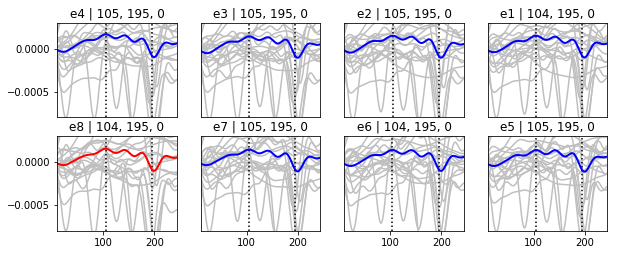

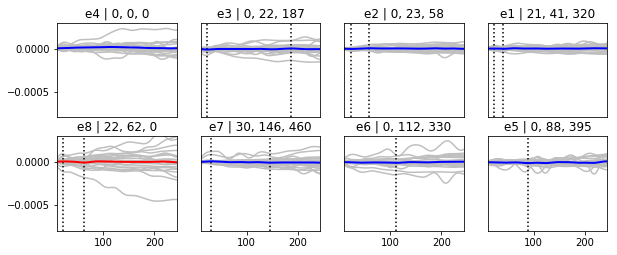

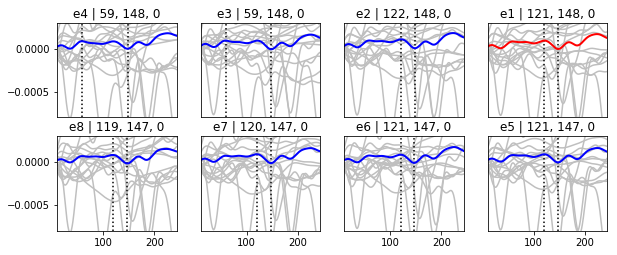

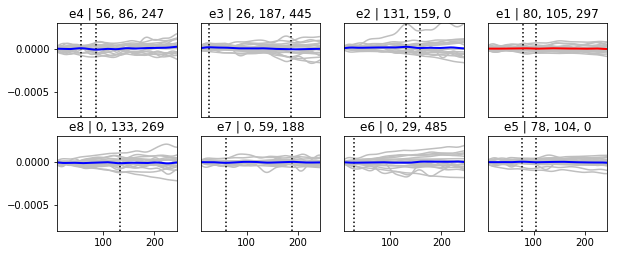

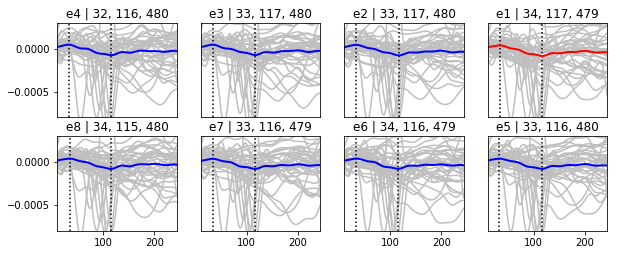

...

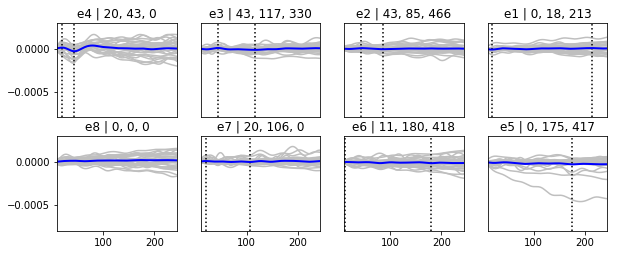

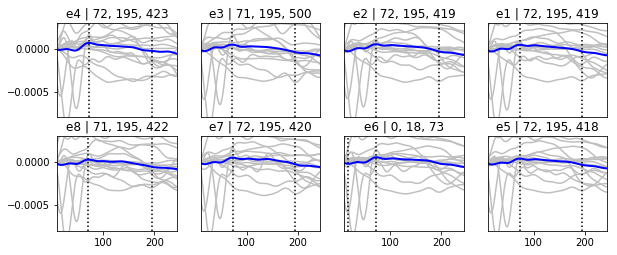

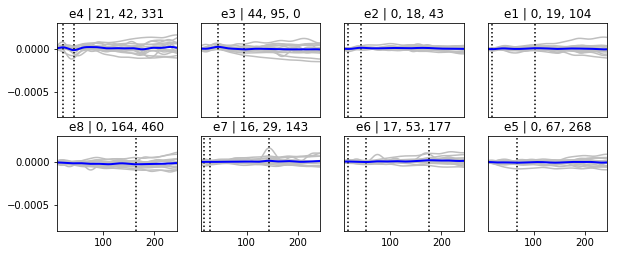

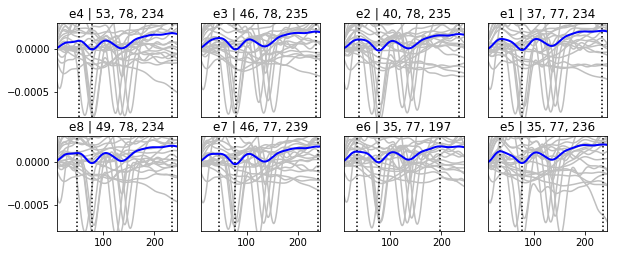

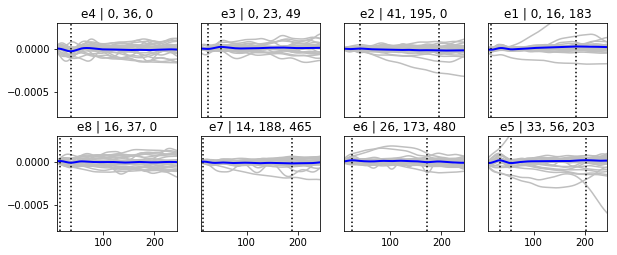

In [22]:
data_path = "/home/pfilipia/inria/chu_nice_inria/patients_ecog/patient08"
timestamp = "20181120_1207"

electrode_ids = np.arange(0, 8)
electrode_names = ['e1', 'e2', 'e3', 'e4', 'e5', 'e6', 'e7', 'e8']

subplot_rows = 4
subplot_cols = 6

subplot_ids = [
    11, 10,  9,  8,
    17, 16, 15, 14
]

offset = 20

run(data_path, timestamp, electrode_ids, electrode_names, subplot_rows, subplot_cols, subplot_ids, offset)